# Objective
Design and implement a basic image-based model that detects common types of vehicle damage such as scratches, dents, or broken parts.

# Written by Dr. Ali Mayya
# Co-operate with: Eng. Ali Altrkby

In [1]:
# mount my drive to load car defects dataset from it
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [24]:
# Unrar the dataset file
## As a result, a folder entitled "Dataset" will apear in the content of COLAB ##
!pip install unrar
!unrar x '/content/drive/MyDrive/Dataset'


UNRAR 6.11 beta 1 freeware      Copyright (c) 1993-2022 Alexander Roshal


Extracting from /content/drive/MyDrive/Dataset.rar

Extracting  Dataset/Images/1 - Copy.jpg                                    0%  OK 

Would you like to replace the existing file Dataset/Images/1.jpg
 60409 bytes, modified on 2025-05-11 04:24
with a new one
 60409 bytes, modified on 2025-05-11 04:24

[Y]es, [N]o, [A]ll, n[E]ver, [R]ename, [Q]uit Y

Extracting  Dataset/Images/1.jpg                                           1%  OK 
Extracting  Dataset/Images/10 - Copy.jpg                                   3%  OK 

Would you like to replace the existing file Dataset/Images/10.jpg
 97826 bytes, modified on 2025-05-11 04:38
with a new one
 97826 bytes, modified on 2025-05-11 04:38

[Y]es, [N]o, [A]ll, n[E]ver, [R]ename, [Q]uit A

Extracting  Dataset/Images/10.jpg                                          4%  OK 
Extracting  Dataset/Images/11 - Copy.jpg                             

In [3]:
# Install Dependencies
# 1- ultralytics for YOLO architecture
!pip install -q ultralytics albumentations

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 27.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 120.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 94.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 60.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 726.9 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 106.7 MB/s eta 0:00:00


In [ ]:
# Dataset images preparation and split into train, val and test
import os, shutil, random
from pathlib import Path
DATA  = f'/content/Dataset'

# dataset will include two folders "Images" and "Labels"
IMGS = Path(DATA) / 'Images'
LABS = Path(DATA) / 'Labels'

# Create three dataset's folders inside the main directory "content/Dataset/" into three folders: train, val and test
for split in ('train','val','test'):
    for sub in ('images','labels'):
        os.makedirs(Path(DATA)/split/sub, exist_ok=True)

# Shuffle the dataset files
all_files = [f.stem for f in IMGS.glob('*.jpg')]
random.seed(42)
random.shuffle(all_files)

# Define each split ration: 60% train, 30% val, 10% test (We can later modify this ratio)
n = len(all_files)
n_train = int(n*0.6)
n_val   = int(n*0.3)

# Apply the splits so the dataset images will be distributed among the three folders
splits = {
    'train': all_files[:n_train],
    'val'  : all_files[n_train:n_train+n_val],
    'test' : all_files[n_train+n_val:]
}

# Copy files
for split, names in splits.items():
    for stem in names:
        shutil.copy(IMGS/f'{stem}.jpg', Path(DATA)/split/'images')
        shutil.copy(LABS/f'{stem}.txt', Path(DATA)/split/'labels')

# Write dataset YAML for YOLOv8 model including number of classes:4 and classes names.
yaml_content = f"""
path: {DATA}       # dataset root dir
train: train/images
val:   val/images
test:  test/images

# number of classes
nc: {4}
names: {["broken_glass","Damaged_light_tire_parts","dent","scratch"]}
"""
with open('car_defect.yaml','w') as f:
    f.write(yaml_content.strip())
print("YAML file created:", open('car_defect.yaml').read())

In [26]:
# Create YOLOV8 model (without pretrained weights)
from ultralytics import YOLO

# In this code, we will use the main architecture of model YOLOV8 wihtou loading pretrained weights
model = YOLO('yolov8n.yaml')
model.model.nc = 4
model.model.names = ["broken_glass","Damaged_light_tire_parts","dent","scratch"]


In [27]:
# Training loop
# Input size: 640*640
# Here we add the data augmentation operations
results = model.train(
    data='car_defect.yaml',
    epochs=500,
    imgsz=640,
    batch=64,
    augment=True,           # enable built-in augmentation
    mosaic=True,            # enable mosaic
    mixup=True,             # enable mixup
    degrees=5.0,           # random rotation ±5°
    translate=0.05,          # ±5% translation
    scale=0.15,              # ±15% scale
    fliplr=0.15             # 15% horizontal flip
)

Ultralytics 8.3.131 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=64, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=car_defect.yaml, degrees=5.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=500, erasing=0.4, exist_ok=False, fliplr=0.15, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.yaml, momentum=0.937, mosaic=1.0, multi_scale=False, name=train8, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=True, pr

train: Scanning /content/Dataset/train/labels... 59 images, 0 backgrounds, 0 corrupt: 100%|██████████| 59/59 [00:00<00:00, 1232.06it/s]

train: New cache created: /content/Dataset/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 330.6±120.5 MB/s, size: 73.4 KB)


val: Scanning /content/Dataset/val/labels... 27 images, 0 backgrounds, 0 corrupt: 100%|██████████| 27/27 [00:00<00:00, 521.50it/s]

val: New cache created: /content/Dataset/val/labels.cache


Plotting labels to runs/detect/train8/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train8
Starting training for 500 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/500       7.4G      3.294      4.417       4.22        198        640: 100%|██████████| 1/1 [00:00<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.43it/s]

                   all         27         46    0.00198      0.369    0.00282   0.000989



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/500      7.43G       3.29      4.444      4.199        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]

                   all         27         46    0.00198      0.369    0.00282   0.000989



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/500      7.38G      3.274      4.502      4.247        175        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.24it/s]

                   all         27         46    0.00194      0.369    0.00343    0.00167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/500      7.38G      3.261      4.401      4.262        204        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.08it/s]

                   all         27         46    0.00186      0.369    0.00202   0.000653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/500      7.36G      3.055      4.344       4.25        176        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.35it/s]

                   all         27         46    0.00185      0.369    0.00201   0.000649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/500      7.36G      3.246      4.411      4.256        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.30it/s]

                   all         27         46    0.00213      0.432    0.00366   0.000886



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/500      7.36G       3.14      4.403      4.248        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.87it/s]

                   all         27         46    0.00203      0.401    0.00231   0.000723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/500      7.36G      3.196       4.41      4.226        203        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.81it/s]

                   all         27         46    0.00203      0.401    0.00247   0.000741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/500      7.36G      3.155      4.448      4.236        171        640: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.63it/s]

                   all         27         46    0.00185      0.369    0.00195   0.000675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/500      7.36G      3.063      4.374      4.264        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.17it/s]

                   all         27         46    0.00205      0.401    0.00198   0.000644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/500      7.36G      3.323      4.383      4.225        182        640: 100%|██████████| 1/1 [00:00<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.42it/s]

                   all         27         46      0.002      0.401    0.00194    0.00066



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/500      7.36G      3.131       4.38      4.214        183        640: 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.81it/s]

                   all         27         46    0.00205      0.401    0.00416    0.00298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/500      7.36G      3.276       4.37      4.215        211        640: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.18it/s]

                   all         27         46    0.00205      0.401    0.00186    0.00057



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/500      7.36G      3.224      4.398      4.208        201        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.12it/s]

                   all         27         46    0.00204      0.401    0.00214   0.000698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/500      7.36G       3.25      4.384      4.202        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.67it/s]

                   all         27         46     0.0019      0.369    0.00185   0.000652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/500      7.36G      3.139      4.311        4.2        199        640: 100%|██████████| 1/1 [00:00<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.44it/s]

                   all         27         46    0.00197      0.381    0.00219   0.000718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/500      7.36G      3.148      4.335      4.195        184        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.14it/s]

                   all         27         46     0.0021      0.401    0.00371    0.00143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/500      7.36G      3.081      4.254      4.177        179        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.66it/s]

                   all         27         46    0.00205      0.381    0.00253   0.000911



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/500      7.36G      3.356      4.321      4.167        211        640: 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.42it/s]

                   all         27         46    0.00186       0.35    0.00205    0.00068



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/500      7.38G      3.253      4.241      4.167        188        640: 100%|██████████| 1/1 [00:00<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.93it/s]

                   all         27         46    0.00219      0.432    0.00402    0.00102



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/500      7.38G      3.114      4.299       4.16        171        640: 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.40s/it]

                   all         27         46    0.00193      0.381    0.00266    0.00101



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/500      7.42G      3.183      4.338      4.155        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.23it/s]

                   all         27         46    0.00205      0.401    0.00298   0.000856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/500      7.38G      3.152      4.211      4.144        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.02it/s]

                   all         27         46    0.00204      0.401    0.00275   0.000809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/500      7.38G      3.263      4.301      4.151        181        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]

                   all         27         46    0.00204      0.401    0.00326   0.000875



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/500      7.42G      3.099      4.143      4.122        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.37it/s]

                   all         27         46    0.00189      0.369    0.00271   0.000941



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/500      7.38G      3.036      4.223      4.132        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.45it/s]

                   all         27         46    0.00194      0.381    0.00366    0.00119



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/500      7.38G      3.344      4.181      4.114        197        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]

                   all         27         46    0.00198      0.381    0.00438    0.00153



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/500      7.38G      3.189      4.202      4.115        199        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]

                   all         27         46    0.00208      0.413    0.00356    0.00121



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/500      7.38G      3.207      4.196      4.119        200        640: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.31it/s]

                   all         27         46    0.00205      0.413    0.00321    0.00115



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/500      7.45G       3.04      4.074      4.107        206        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.07it/s]

                   all         27         46    0.00198      0.393    0.00335     0.0012



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/500      7.38G      3.249      4.083      4.089        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.04it/s]

                   all         27         46    0.00198      0.381    0.00343    0.00117



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/500      7.46G      3.097      4.063      4.096        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]

                   all         27         46    0.00192      0.381    0.00303    0.00108



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/500      7.38G      3.142      4.017      4.077        222        640: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.87it/s]

                   all         27         46    0.00208      0.413    0.00346    0.00113



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/500      7.37G      3.023      4.057      4.058        179        640: 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]

                   all         27         46    0.00225      0.432    0.00388     0.0011



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/500      7.37G      3.164       4.07       4.07        208        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.45it/s]

                   all         27         46    0.00196      0.381    0.00367    0.00129



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/500      7.37G      3.009      4.076      3.999        172        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.64it/s]

                   all         27         46    0.00198      0.381    0.00628    0.00187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/500      7.37G      2.816      3.966      3.999        167        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.82it/s]

                   all         27         46    0.00201      0.381    0.00676    0.00141



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/500      7.37G      3.183      4.032      4.025        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.91it/s]

                   all         27         46    0.00213      0.413    0.00356    0.00107



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/500      7.37G      3.055      4.009      3.983        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.71it/s]

                   all         27         46    0.00212      0.413    0.00519    0.00351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/500      7.37G      3.084      4.004      3.951        183        640: 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.36it/s]

                   all         27         46     0.0021      0.413     0.0113    0.00194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/500      7.37G      3.088      3.989      3.954        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.02it/s]

                   all         27         46    0.00197      0.381    0.00475    0.00165



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/500      7.42G      2.976       3.94      3.915        170        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]

                   all         27         46    0.00214      0.413    0.00785    0.00177



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/500      7.38G      3.032      3.953      3.939        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.11it/s]

                   all         27         46    0.00197      0.381    0.00451    0.00179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/500      7.37G      2.917      3.947       3.88        158        640: 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.74it/s]

                   all         27         46    0.00202      0.393    0.00354    0.00118



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/500      7.37G       2.98      3.876       3.89        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.18it/s]

                   all         27         46    0.00213      0.413    0.00385    0.00125



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/500      7.37G      3.116      3.981      3.847        218        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.64it/s]

                   all         27         46    0.00201      0.381    0.00463    0.00146



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/500      7.37G      3.005       3.89      3.838        208        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.26it/s]

                   all         27         46    0.00188       0.35     0.0023    0.00086



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/500      7.37G       2.84       3.84       3.83        199        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.36it/s]

                   all         27         46     0.0021      0.401     0.0034    0.00112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/500      7.37G      3.107      3.796      3.849        238        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.63it/s]

                   all         27         46    0.00201      0.393    0.00301   0.000941



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/500      7.37G      2.969      3.736      3.779        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.13it/s]

                   all         27         46    0.00224      0.432    0.00353    0.00105



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/500      7.37G      2.954      3.772      3.743        198        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.15it/s]

                   all         27         46    0.00205      0.381    0.00301   0.000907



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/500      7.37G      2.995      3.734       3.78        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.69it/s]

                   all         27         46    0.00216      0.401    0.00347    0.00128



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/500      7.37G      2.893      3.749      3.723        171        640: 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.40it/s]

                   all         27         46    0.00192       0.35    0.00486     0.0014



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/500      7.37G      3.055      3.701      3.738        217        640: 100%|██████████| 1/1 [00:00<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.15it/s]

                   all         27         46    0.00198       0.38     0.0027   0.000771



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/500      7.37G      2.894      3.722       3.65        170        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.87it/s]

                   all         27         46    0.00224      0.432     0.0049    0.00129



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/500      7.37G      2.885      3.641      3.689        216        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.06it/s]

                   all         27         46    0.00206      0.381    0.00757    0.00183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/500      7.37G      2.909      3.719      3.638        182        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]

                   all         27         46     0.0022      0.401    0.00441    0.00126



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/500      7.37G      2.973      3.774      3.644        215        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.17it/s]

                   all         27         46    0.00193      0.361     0.0028   0.000805



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/500      7.38G      2.866       3.63       3.55        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.38it/s]

                   all         27         46    0.00191       0.35    0.00291   0.000866



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/500      7.43G      2.799       3.74      3.581        179        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.45it/s]

                   all         27         46      0.002      0.381    0.00341    0.00106



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/500      7.42G      2.918        3.6      3.518        200        640: 100%|██████████| 1/1 [00:00<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.36it/s]

                   all         27         46    0.00224      0.432    0.00435    0.00112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/500      7.38G      2.794      3.635      3.571        200        640: 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.92it/s]

                   all         27         46    0.00185       0.35    0.00395    0.00123



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/500      7.42G      2.847      3.591      3.501        199        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.94it/s]

                   all         27         46    0.00185      0.361    0.00334   0.000842



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/500      7.38G      2.968      3.648      3.489        211        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]

                   all         27         46    0.00192       0.35     0.0057    0.00144



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/500      7.38G      2.829      3.649      3.502        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]

                   all         27         46    0.00192       0.35    0.00523    0.00125



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/500      7.42G      2.821      3.462      3.391        213        640: 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]

                   all         27         46    0.00195      0.361    0.00411    0.00127



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/500      7.45G      2.732      3.585      3.415        200        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.33it/s]

                   all         27         46    0.00182      0.329    0.00493    0.00124



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/500      7.38G      2.784      3.486      3.363        175        640: 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.11it/s]

                   all         27         46    0.00255      0.369    0.00414    0.00113



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/500      7.43G      2.816      3.391      3.374        197        640: 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.57it/s]

                   all         27         46    0.00216      0.381    0.00416    0.00108



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/500      7.37G      2.626      3.549      3.354        167        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.96it/s]

                   all         27         46    0.00201      0.369    0.00402    0.00113



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/500      7.37G      2.796      3.611      3.333        189        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.77it/s]

                   all         27         46     0.0021      0.411    0.00381   0.000901



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/500      7.37G      2.713      3.359       3.32        216        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.72it/s]

                   all         27         46    0.00215      0.401    0.00288   0.000859



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/500      7.37G      2.823       3.44      3.407        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.77it/s]

                   all         27         46   0.000699      0.177    0.00128   0.000356



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/500      7.37G      2.744      3.503      3.278        200        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.32it/s]

                   all         27         46   0.000689      0.177    0.00141   0.000438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/500      7.37G      2.728      3.364      3.313        172        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.12it/s]

                   all         27         46   0.000778      0.188     0.0016    0.00048



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/500      7.37G      2.641      3.404      3.248        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.09it/s]

                   all         27         46   0.000737      0.177    0.00116   0.000442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/500      7.37G      2.699      3.297      3.251        205        640: 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.66it/s]

                   all         27         46     0.0031      0.229    0.00447     0.0011



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/500      7.37G      2.623      3.294      3.243        190        640: 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.42it/s]

                   all         27         46     0.0023       0.26    0.00378     0.0013



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/500      7.37G      2.645      3.385      3.201        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.30it/s]

                   all         27         46    0.00162      0.219    0.00288   0.000914



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/500      7.37G      2.617      3.247      3.174        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.35it/s]

                   all         27         46    0.00246       0.26    0.00327   0.000969



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/500      7.37G      2.624      3.299      3.215        190        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.71it/s]

                   all         27         46    0.00215       0.25    0.00232   0.000673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/500      7.37G      2.476      3.365      3.145        177        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]

                   all         27         46    0.00252      0.281    0.00255   0.000698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/500      7.37G      2.605      3.192      3.134        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.88it/s]

                   all         27         46    0.00198      0.198    0.00181   0.000572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/500      7.37G       2.57      3.316      3.105        175        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.58it/s]

                   all         27         46    0.00458      0.318    0.00403   0.000954



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/500      7.42G      2.619      3.405      3.198        189        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.20it/s]

                   all         27         46    0.00216      0.214    0.00316   0.000894



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/500      7.38G      2.481       3.28      3.099        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.68it/s]

                   all         27         46    0.00226       0.26    0.00355    0.00109



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/500      7.38G      2.558       3.19      3.133        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]

                   all         27         46    0.00236      0.282     0.0036    0.00117



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/500      7.38G      2.504      3.252      3.212        199        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.79it/s]

                   all         27         46    0.00267      0.245    0.00311   0.000912



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/500      7.38G      2.501      3.201      3.044        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.70it/s]

                   all         27         46     0.0027      0.301      0.004    0.00149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/500      7.38G       2.56      3.094          3        206        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.85it/s]

                   all         27         46    0.00223      0.301     0.0041    0.00155



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/500      7.38G      2.491      3.181      3.125        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.49it/s]

                   all         27         46    0.00239      0.312     0.0208     0.0107



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/500      7.42G      2.473      3.116      3.024        188        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.64it/s]

                   all         27         46    0.00244      0.292    0.00505    0.00219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/500      7.42G      2.356      3.092      2.982        188        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.50it/s]

                   all         27         46    0.00078      0.177    0.00125    0.00054



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/500      7.38G      2.501       3.01      3.095        216        640: 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.65it/s]

                   all         27         46    0.00241      0.331    0.00333    0.00112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/500      7.42G      2.514      3.086      3.033        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.34it/s]

                   all         27         46    0.00192      0.343    0.00287   0.000983



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/500      7.37G      2.415      3.213      2.987        182        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.92it/s]

                   all         27         46    0.00194        0.3    0.00253   0.000981



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/500      7.37G      2.494      3.128      2.975        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.17it/s]

                   all         27         46    0.00226      0.254    0.00246   0.000848



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/500      7.37G        2.4       3.03      3.025        204        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]

                   all         27         46    0.00262      0.273    0.00262   0.000868



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/500      7.37G      2.387      3.088      2.989        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.23it/s]

                   all         27         46    0.00217      0.292    0.00273   0.000942



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/500      7.37G      2.289      3.039      2.925        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.34it/s]

                   all         27         46    0.00196      0.374    0.00299   0.000827



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/500      7.37G      2.367      3.137      2.889        160        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.42it/s]

                   all         27         46    0.00146      0.259    0.00579    0.00211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/500      7.37G       2.46       3.06      2.975        204        640: 100%|██████████| 1/1 [00:00<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.92it/s]

                   all         27         46    0.00152      0.186    0.00438    0.00157



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/500      7.37G      2.278      2.975      2.815        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.41it/s]

                   all         27         46    0.00138      0.248     0.0021   0.000801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/500      7.38G      2.302      2.983      2.857        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.91it/s]

                   all         27         46    0.00153      0.216    0.00209   0.000784



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/500      7.37G      2.309      2.958      2.921        203        640: 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.63it/s]

                   all         27         46    0.00217      0.266    0.00374   0.000796



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/500      7.37G      2.313      2.744      2.845        209        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.79it/s]

                   all         27         46    0.00243      0.278    0.00333   0.000773



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/500      7.37G      2.303      2.789      2.754        179        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.20it/s]


                   all         27         46    0.00269      0.163    0.00297   0.000762

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/500      7.37G      2.354      2.905      2.842        190        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.19it/s]


                   all         27         46    0.00121      0.144    0.00194   0.000757

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/500      7.37G        2.3      2.877      2.813        201        640: 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.92it/s]

                   all         27         46    0.00191      0.163    0.00265   0.000786



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/500      7.37G      2.198      2.837      2.742        175        640: 100%|██████████| 1/1 [00:00<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.16it/s]

                   all         27         46    0.00242      0.266    0.00373    0.00086



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/500      7.37G      2.271      2.884      2.799        203        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.72it/s]

                   all         27         46    0.00211      0.266    0.00415   0.000901



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/500      7.37G      2.299      2.958      2.795        188        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.07it/s]

                   all         27         46    0.00225      0.297    0.00502   0.000909



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/500      7.37G      2.254      2.743      2.731        184        640: 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]

                   all         27         46    0.00161      0.216    0.00359   0.000747



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/500      7.37G      2.309      2.809      2.751        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]

                   all         27         46     0.0023      0.247    0.00532   0.000996



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/500      7.37G      2.373      2.893      2.758        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.71it/s]

                   all         27         46    0.00343      0.247     0.0105    0.00148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/500      7.37G      2.202      2.801      2.715        204        640: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.93it/s]

                   all         27         46    0.00408      0.247     0.0442     0.0058



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/500      7.37G      2.167      2.749      2.761        181        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.63it/s]

                   all         27         46    0.00408      0.247     0.0186    0.00285



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/500      7.37G      2.124      2.708      2.708        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.87it/s]

                   all         27         46    0.00444      0.235     0.0106    0.00327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/500      7.37G      2.138      2.688      2.707        200        640: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.91it/s]

                   all         27         46    0.00275      0.254    0.00825    0.00245



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/500      7.38G      2.187      2.606      2.646        204        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.15it/s]

                   all         27         46    0.00257      0.313     0.0134     0.0048



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/500      7.38G      2.191      2.692      2.727        202        640: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.74it/s]

                   all         27         46    0.00263      0.333     0.0162    0.00409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/500      7.38G      2.138      2.654      2.656        196        640: 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.65it/s]

                   all         27         46    0.00302      0.345       0.01    0.00226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/500      7.42G       2.14      2.756      2.674        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]

                   all         27         46    0.00321      0.264    0.00841    0.00246



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/500      7.37G      2.184      2.689      2.671        189        640: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]

                   all         27         46    0.00401      0.192     0.0115    0.00348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/500      7.37G       2.08      2.515      2.605        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.00it/s]

                   all         27         46    0.00676      0.212     0.0223    0.00885



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/500      7.37G      2.186      2.714      2.621        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.57it/s]

                   all         27         46       0.93     0.0208     0.0514     0.0268



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/500      7.37G      2.052      2.584      2.578        207        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.85it/s]

                   all         27         46      0.935     0.0208     0.0368     0.0169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/500      7.37G       2.06      2.581      2.557        202        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.42it/s]

                   all         27         46        0.8     0.0208     0.0194    0.00666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/500      7.37G      2.076      2.617      2.635        199        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.82it/s]

                   all         27         46      0.839     0.0208     0.0418     0.0137



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/500      7.37G      2.027      2.584      2.578        188        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.28it/s]

                   all         27         46      0.825     0.0208     0.0499     0.0179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/500      7.37G      1.986       2.62      2.568        177        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.51it/s]

                   all         27         46      0.294     0.0713     0.0838     0.0332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/500      7.37G       1.98      2.516       2.53        203        640: 100%|██████████| 1/1 [00:00<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.46it/s]

                   all         27         46      0.326     0.0593      0.123     0.0394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/500      7.37G      1.992      2.671      2.555        174        640: 100%|██████████| 1/1 [00:00<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.26it/s]

                   all         27         46      0.365      0.153      0.169     0.0605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/500      7.37G      2.089      2.568      2.624        221        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.84it/s]

                   all         27         46      0.344      0.134      0.139     0.0556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/500      7.37G       1.99      2.552      2.487        196        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.21it/s]

                   all         27         46      0.906     0.0625      0.122     0.0405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/500      7.37G      1.955      2.412      2.486        199        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.95it/s]

                   all         27         46        0.8     0.0625     0.0777      0.027



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/500      7.37G      1.955      2.539      2.506        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.47it/s]

                   all         27         46      0.303     0.0521       0.05     0.0116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/500      7.37G      1.995      2.379      2.503        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]

                   all         27         46      0.374     0.0206     0.0477      0.016



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/500      7.37G      1.922      2.358      2.475        177        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.00it/s]

                   all         27         46        0.3     0.0417      0.075      0.019



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/500      7.37G      1.912      2.358      2.405        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]

                   all         27         46      0.643      0.104      0.122     0.0415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/500      7.37G      1.937      2.355      2.424        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.02it/s]

                   all         27         46       0.16      0.174      0.141     0.0642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/500      7.37G      1.912      2.362      2.449        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.46it/s]

                   all         27         46      0.273      0.208      0.148     0.0652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/500      7.37G      2.011      2.268      2.405        204        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.05it/s]

                   all         27         46      0.866     0.0625       0.18     0.0588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    144/500      7.37G      1.986      2.428      2.458        197        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.10it/s]

                   all         27         46      0.866     0.0625      0.136     0.0488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    145/500      7.37G      1.963      2.267      2.503        213        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.17it/s]

                   all         27         46      0.277      0.208      0.113     0.0499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    146/500      7.37G       1.81      2.264      2.374        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.22it/s]

                   all         27         46      0.233      0.224       0.11     0.0555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    147/500      7.37G       1.93      2.364      2.449        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]

                   all         27         46      0.129      0.245      0.118     0.0494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    148/500      7.37G      1.841       2.33      2.376        159        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.69it/s]

                   all         27         46      0.401      0.224      0.128     0.0507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    149/500      7.37G      1.882      2.291      2.324        170        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.62it/s]

                   all         27         46      0.598      0.104      0.125     0.0493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    150/500      7.37G      1.876      2.323      2.443        203        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.07it/s]

                   all         27         46      0.396      0.306      0.103      0.045



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    151/500      7.38G      1.891      2.296       2.33        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.75it/s]

                   all         27         46      0.146      0.226      0.124      0.056



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    152/500      7.37G      1.961      2.406      2.459        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]

                   all         27         46      0.144      0.247      0.116     0.0471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    153/500      7.37G      1.891      2.278      2.403        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.52it/s]

                   all         27         46      0.119      0.257      0.112     0.0439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    154/500      7.37G      1.848      2.377      2.369        220        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.69it/s]

                   all         27         46      0.145      0.257      0.106     0.0411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    155/500      7.37G      1.933      2.203      2.393        221        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.27it/s]

                   all         27         46      0.145      0.311      0.139     0.0602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    156/500      7.37G       1.94      2.291      2.296        215        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.97it/s]

                   all         27         46      0.242      0.372      0.146     0.0675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    157/500      7.37G      1.878      2.189      2.351        197        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.14it/s]

                   all         27         46      0.224      0.309      0.154      0.079



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    158/500      7.37G      1.707      2.161      2.266        190        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.43it/s]

                   all         27         46      0.656      0.143      0.172     0.0802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    159/500      7.37G      1.779       2.18      2.322        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.17it/s]

                   all         27         46      0.655      0.105      0.206     0.0883



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    160/500      7.37G      1.896      2.203      2.366        207        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.20it/s]

                   all         27         46      0.628      0.198      0.199     0.0958



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    161/500      7.37G       1.81      2.146      2.274        205        640: 100%|██████████| 1/1 [00:00<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]

                   all         27         46      0.495      0.269      0.259      0.134



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    162/500      7.37G      1.791      2.056      2.296        177        640: 100%|██████████| 1/1 [00:00<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]

                   all         27         46      0.292      0.389       0.26      0.135



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    163/500      7.37G      1.726      2.023      2.227        197        640: 100%|██████████| 1/1 [00:00<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.22it/s]

                   all         27         46       0.33      0.465      0.295      0.164



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    164/500      7.37G       1.79      2.066      2.316        215        640: 100%|██████████| 1/1 [00:00<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]

                   all         27         46      0.428      0.392      0.382       0.21



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    165/500      7.37G       1.78      2.123      2.267        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.65it/s]

                   all         27         46      0.533      0.379      0.416       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    166/500      7.37G      1.696      2.018       2.24        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.32it/s]

                   all         27         46      0.538      0.312       0.36        0.2



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    167/500      7.38G       1.84       2.11      2.352        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.03it/s]

                   all         27         46      0.521      0.345      0.345      0.167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    168/500      7.38G      1.731      2.031      2.291        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.70it/s]

                   all         27         46      0.529      0.296      0.312      0.163



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    169/500      7.43G      1.717      2.086      2.277        200        640: 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.81it/s]

                   all         27         46      0.528      0.277      0.334      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    170/500      7.43G       1.68      1.971      2.192        188        640: 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.41it/s]

                   all         27         46      0.459      0.343      0.412      0.238



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    171/500      7.38G      1.754      1.996      2.219        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.07it/s]

                   all         27         46      0.505      0.401      0.407      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    172/500      7.42G      1.623      2.056       2.21        177        640: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.87it/s]

                   all         27         46      0.509      0.458      0.421       0.23



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    173/500      7.37G      1.802      2.059      2.293        202        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.37it/s]

                   all         27         46      0.633      0.346      0.426        0.2



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    174/500      7.37G      1.665      1.884      2.236        178        640: 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.76it/s]

                   all         27         46      0.565      0.405      0.412      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    175/500      7.37G       1.77      2.083      2.271        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.34it/s]

                   all         27         46      0.622       0.36      0.419      0.238



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    176/500      7.37G      1.676      1.881       2.16        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.09it/s]

                   all         27         46      0.661      0.371      0.468      0.271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    177/500      7.37G      1.629      2.053      2.188        144        640: 100%|██████████| 1/1 [00:00<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.13it/s]

                   all         27         46      0.617      0.554      0.484      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    178/500      7.37G      1.686      1.939      2.178        175        640: 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]

                   all         27         46       0.74      0.536       0.52      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    179/500      7.37G      1.583      1.864      2.146        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]

                   all         27         46      0.745      0.494      0.582      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    180/500      7.37G      1.676      1.816      2.201        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.57it/s]

                   all         27         46        0.7      0.528      0.583      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    181/500      7.37G      1.635      1.844      2.189        188        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.70it/s]

                   all         27         46      0.527      0.636      0.594      0.365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    182/500      7.37G       1.66      1.857      2.119        190        640: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.35it/s]

                   all         27         46      0.641      0.518      0.598      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    183/500      7.37G       1.62      1.909      2.193        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.38it/s]

                   all         27         46      0.771      0.523      0.602      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    184/500      7.42G      1.688       1.89      2.149        197        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.16it/s]

                   all         27         46      0.753       0.52      0.608      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    185/500      7.36G      1.569      1.884      2.117        184        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.79it/s]

                   all         27         46      0.845      0.471      0.617      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    186/500      7.36G      1.609      1.889      2.178        172        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.83it/s]

                   all         27         46       0.69      0.495      0.626       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    187/500      7.36G      1.608      1.701      2.112        205        640: 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.36it/s]

                   all         27         46      0.618      0.594      0.634      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    188/500      7.36G      1.692      1.961       2.16        188        640: 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.45it/s]

                   all         27         46      0.686      0.564      0.618      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    189/500      7.36G      1.667      1.843      2.171        190        640: 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.91it/s]

                   all         27         46      0.639      0.604       0.63       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    190/500      7.36G      1.617       1.74       2.13        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.99it/s]

                   all         27         46      0.757      0.585      0.618       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    191/500      7.36G       1.59       1.87      2.128        196        640: 100%|██████████| 1/1 [00:00<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.08it/s]

                   all         27         46      0.704       0.57      0.614      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    192/500      7.36G      1.568      1.782      2.095        198        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.74it/s]

                   all         27         46      0.816      0.542      0.651      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    193/500      7.36G      1.564      1.825      2.135        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.74it/s]

                   all         27         46      0.784      0.523      0.641      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    194/500      7.36G      1.632      1.912      2.119        182        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.60it/s]

                   all         27         46      0.784      0.539      0.651      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    195/500      7.36G        1.6      1.664      2.077        209        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.49it/s]

                   all         27         46      0.792      0.516      0.653      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    196/500      7.36G      1.627      1.759      2.125        211        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.74it/s]

                   all         27         46       0.75      0.589      0.716      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    197/500      7.36G      1.789      1.894      2.144        205        640: 100%|██████████| 1/1 [00:00<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.86it/s]

                   all         27         46      0.769      0.631      0.675      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    198/500      7.36G      1.616      1.798      2.092        198        640: 100%|██████████| 1/1 [00:00<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.08it/s]

                   all         27         46      0.717      0.624      0.652      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    199/500      7.36G      1.593      1.748      2.096        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.49it/s]

                   all         27         46      0.739      0.589      0.633      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    200/500      7.37G      1.636      1.853      2.121        171        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.18it/s]

                   all         27         46       0.85      0.561      0.635      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    201/500      7.37G      1.615      1.941      2.107        181        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.21it/s]

                   all         27         46      0.875      0.585       0.67      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    202/500      7.37G      1.544      1.754      2.065        177        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.27it/s]

                   all         27         46      0.799      0.608      0.687      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    203/500      7.37G      1.578      1.765       2.04        207        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.25it/s]

                   all         27         46      0.883      0.599      0.695      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    204/500      7.37G      1.511      1.625      2.047        201        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.59it/s]

                   all         27         46       0.86      0.635      0.711      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    205/500      7.37G      1.577      1.748       2.03        198        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.03it/s]

                   all         27         46      0.766      0.657      0.728      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    206/500      7.37G      1.574      1.685      2.131        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.45it/s]

                   all         27         46      0.917      0.605      0.737      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    207/500      7.37G      1.526       1.69       2.08        178        640: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.35it/s]

                   all         27         46      0.644      0.773      0.719      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    208/500      7.37G      1.517       1.69      2.051        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]

                   all         27         46      0.644       0.77       0.71      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    209/500      7.37G      1.545      1.731      2.031        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.18it/s]

                   all         27         46      0.726      0.697      0.704      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    210/500      7.37G      1.447      1.592      2.005        172        640: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.24it/s]

                   all         27         46      0.761      0.619      0.681      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    211/500      7.37G      1.517      1.592      1.988        170        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.43it/s]

                   all         27         46      0.725      0.653      0.679       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    212/500      7.38G      1.499       1.66      2.041        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.59it/s]

                   all         27         46      0.619      0.719      0.686      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    213/500      7.44G        1.6      1.744      2.036        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.81it/s]

                   all         27         46      0.647       0.76      0.695      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    214/500      7.43G      1.522      1.578      1.973        189        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.48it/s]

                   all         27         46      0.763       0.67      0.725      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    215/500      7.38G      1.494      1.579      1.969        190        640: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.55it/s]

                   all         27         46       0.77      0.615      0.721      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    216/500      7.43G      1.504      1.624      2.005        188        640: 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]

                   all         27         46      0.795      0.611      0.712      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    217/500      7.37G      1.515      1.608      2.017        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.89it/s]

                   all         27         46      0.863      0.684      0.718      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    218/500      7.37G      1.485       1.54      1.965        201        640: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.38it/s]

                   all         27         46       0.91      0.683      0.759      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    219/500      7.37G      1.464      1.572      1.974        198        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.46it/s]

                   all         27         46      0.757      0.724      0.755      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    220/500      7.37G      1.469      1.661      1.965        189        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.85it/s]

                   all         27         46      0.769      0.711       0.75      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    221/500      7.37G      1.531      1.675      2.036        190        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.21it/s]

                   all         27         46      0.935      0.638      0.753      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    222/500      7.37G      1.545      1.763      2.057        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.33it/s]

                   all         27         46      0.791      0.683      0.732      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    223/500      7.37G       1.48      1.591      1.949        216        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.06it/s]

                   all         27         46      0.845      0.636      0.764      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    224/500      7.37G      1.438      1.556       1.99        214        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.68it/s]

                   all         27         46      0.747      0.704      0.776       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    225/500      7.37G      1.545      1.624      2.049        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.71it/s]

                   all         27         46      0.878      0.672       0.77      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    226/500      7.37G      1.383      1.484      1.968        168        640: 100%|██████████| 1/1 [00:00<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.38it/s]

                   all         27         46      0.875       0.74      0.766      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    227/500      7.37G      1.458      1.511      1.908        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.10it/s]

                   all         27         46      0.784      0.767      0.768      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    228/500      7.37G      1.459      1.674      1.951        182        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]

                   all         27         46      0.775      0.712      0.749      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    229/500      7.37G      1.435      1.558      1.899        166        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.38s/it]

                   all         27         46      0.792      0.726      0.747      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    230/500      7.37G      1.478      1.633       1.97        196        640: 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.86it/s]

                   all         27         46       0.73       0.73      0.742      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    231/500      7.37G      1.422      1.519      1.944        183        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.11it/s]

                   all         27         46      0.813      0.655      0.741       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    232/500      7.38G      1.449      1.563      1.933        197        640: 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.54it/s]

                   all         27         46      0.718      0.662      0.715      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    233/500      7.42G      1.428      1.579      1.954        188        640: 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.39it/s]

                   all         27         46      0.856      0.543      0.694      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    234/500      7.38G      1.417       1.59      1.945        196        640: 100%|██████████| 1/1 [00:01<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.97it/s]

                   all         27         46      0.712      0.497      0.619      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    235/500      7.38G      1.482      1.624      1.986        189        640: 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.82it/s]

                   all         27         46      0.647      0.569        0.6      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    236/500      7.42G      1.467      1.641      1.961        196        640: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.68it/s]

                   all         27         46      0.633      0.567      0.642      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    237/500      7.37G      1.427      1.441      1.932        188        640: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.30it/s]

                   all         27         46      0.653      0.683      0.682      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    238/500      7.37G      1.433      1.548       1.95        202        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]

                   all         27         46      0.761      0.662        0.7      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    239/500      7.37G      1.383       1.58      1.887        166        640: 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.52it/s]

                   all         27         46      0.702      0.672      0.703      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    240/500      7.37G      1.436      1.425      1.921        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.48it/s]

                   all         27         46      0.623      0.633      0.679      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    241/500      7.37G      1.399       1.53      1.923        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]

                   all         27         46      0.585      0.663      0.671      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    242/500      7.37G      1.465      1.543       1.92        181        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.02it/s]

                   all         27         46      0.663      0.642      0.682      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    243/500      7.37G      1.405      1.451      1.928        182        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.03it/s]

                   all         27         46      0.706      0.675      0.702      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    244/500      7.38G      1.405      1.514      1.897        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.21it/s]

                   all         27         46      0.762      0.625        0.7       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    245/500      7.38G      1.314      1.478      1.861        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.38it/s]

                   all         27         46      0.791      0.651      0.728      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    246/500      7.43G       1.38      1.498      1.928        196        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.94it/s]

                   all         27         46      0.696      0.757      0.741      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    247/500      7.42G      1.403      1.428      1.943        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.29it/s]

                   all         27         46      0.917      0.649      0.749      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    248/500      7.42G      1.368      1.386      1.883        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.36it/s]

                   all         27         46      0.834      0.716      0.752      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    249/500      7.42G      1.392      1.468      1.906        204        640: 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.38it/s]

                   all         27         46      0.917      0.685      0.759      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    250/500      7.37G      1.329      1.313      1.837        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.63it/s]

                   all         27         46      0.928      0.684      0.764      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    251/500      7.37G      1.373      1.401      1.867        189        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.24it/s]

                   all         27         46      0.848      0.712       0.76      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    252/500      7.37G      1.313      1.335      1.846        184        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.09it/s]

                   all         27         46      0.835      0.757      0.774      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    253/500      7.37G       1.41      1.376      1.895        198        640: 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.88it/s]

                   all         27         46      0.869      0.698       0.77      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    254/500      7.37G      1.361      1.366       1.86        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.16it/s]

                   all         27         46      0.843      0.707      0.762      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    255/500      7.37G      1.377      1.409      1.879        204        640: 100%|██████████| 1/1 [00:00<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.48s/it]

                   all         27         46      0.868      0.692      0.759      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    256/500      7.37G      1.299      1.365      1.818        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.38it/s]

                   all         27         46      0.868      0.686      0.795      0.588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    257/500      7.37G      1.378      1.399      1.871        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.41it/s]

                   all         27         46      0.856      0.721      0.773      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    258/500      7.37G      1.393      1.403        1.8        165        640: 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]

                   all         27         46      0.915      0.735      0.795      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    259/500      7.37G      1.337      1.335      1.802        169        640: 100%|██████████| 1/1 [00:00<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]

                   all         27         46      0.888      0.736      0.791      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    260/500      7.37G      1.383      1.358      1.878        178        640: 100%|██████████| 1/1 [00:00<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]

                   all         27         46      0.932      0.761      0.805      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    261/500      7.37G      1.381      1.461      1.859        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.30it/s]

                   all         27         46      0.808      0.782      0.803      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    262/500      7.37G      1.407      1.348      1.873        220        640: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.86it/s]

                   all         27         46      0.907      0.749      0.792      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    263/500      7.37G        1.3      1.383      1.819        189        640: 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.28it/s]


                   all         27         46      0.935        0.7      0.789      0.588

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    264/500      7.37G      1.397      1.358      1.846        206        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.13it/s]

                   all         27         46      0.784      0.732      0.774      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    265/500      7.38G      1.456      1.403      1.946        213        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.60it/s]

                   all         27         46      0.934      0.658      0.744      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    266/500      7.38G      1.297      1.307       1.85        190        640: 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.61it/s]

                   all         27         46      0.874      0.689      0.744      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    267/500      7.38G      1.312      1.419      1.845        182        640: 100%|██████████| 1/1 [00:00<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.93it/s]

                   all         27         46      0.883      0.696      0.753      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    268/500      7.37G      1.293       1.33      1.833        173        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]

                   all         27         46      0.939      0.708      0.762      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    269/500      7.37G      1.288      1.338      1.822        190        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.19it/s]

                   all         27         46      0.955      0.674       0.76      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    270/500      7.37G      1.343      1.378      1.869        181        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.36it/s]

                   all         27         46       0.95      0.674      0.762      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    271/500      7.37G      1.308      1.292      1.801        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.86it/s]

                   all         27         46      0.942      0.683      0.763      0.588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    272/500      7.37G      1.341      1.305      1.886        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.89it/s]

                   all         27         46      0.958      0.697      0.761      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    273/500      7.37G      1.369      1.388      1.867        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]

                   all         27         46      0.881       0.72      0.754      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    274/500      7.37G      1.381       1.32      1.844        204        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.95it/s]

                   all         27         46      0.907      0.708      0.752      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    275/500      7.37G       1.35      1.344      1.842        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.75it/s]

                   all         27         46      0.934      0.703      0.754      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    276/500      7.37G      1.322      1.342      1.838        202        640: 100%|██████████| 1/1 [00:00<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.07s/it]

                   all         27         46      0.933        0.7      0.757      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    277/500      7.37G      1.333      1.427      1.808        191        640: 100%|██████████| 1/1 [00:01<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.39s/it]

                   all         27         46      0.942      0.714      0.755      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    278/500      7.37G      1.333      1.335      1.856        203        640: 100%|██████████| 1/1 [00:00<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.67it/s]

                   all         27         46      0.951      0.719      0.756      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    279/500      7.37G      1.269      1.215      1.775        205        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.87it/s]

                   all         27         46      0.899      0.742       0.76      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    280/500      7.37G      1.243      1.214      1.808        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.38it/s]

                   all         27         46      0.906      0.744      0.762      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    281/500      7.37G       1.25      1.299      1.797        175        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.31it/s]

                   all         27         46       0.92      0.759      0.771      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    282/500      7.37G      1.275      1.207      1.805        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.20it/s]

                   all         27         46      0.933       0.75       0.78      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    283/500      7.38G      1.275       1.31      1.841        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.46it/s]

                   all         27         46      0.919      0.749      0.785      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    284/500      7.38G      1.327      1.304      1.774        216        640: 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.65it/s]

                   all         27         46      0.919      0.754      0.784      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    285/500      7.37G      1.232      1.232      1.727        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.09it/s]

                   all         27         46      0.921      0.763      0.787      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    286/500      7.37G      1.227       1.21      1.738        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.18it/s]

                   all         27         46      0.955      0.753      0.785      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    287/500      7.37G      1.287      1.294      1.847        189        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.23it/s]

                   all         27         46      0.931      0.724      0.776      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    288/500      7.37G      1.287      1.183      1.815        182        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.35it/s]

                   all         27         46      0.957      0.723      0.778      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    289/500      7.37G      1.242      1.206      1.726        179        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.71it/s]

                   all         27         46      0.939      0.718      0.784      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    290/500      7.37G      1.252      1.252      1.753        237        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.73it/s]

                   all         27         46      0.963       0.72      0.788      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    291/500      7.37G      1.293      1.269      1.763        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.64it/s]

                   all         27         46      0.877      0.763       0.78      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    292/500      7.37G      1.338      1.256      1.794        196        640: 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.37it/s]

                   all         27         46      0.838      0.742      0.755      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    293/500      7.37G      1.237       1.29      1.785        188        640: 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.59it/s]

                   all         27         46      0.952      0.676      0.752      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    294/500      7.37G      1.253      1.218      1.711        218        640: 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.95it/s]

                   all         27         46      0.938      0.677      0.751      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    295/500      7.37G       1.28      1.267      1.782        169        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.90it/s]

                   all         27         46      0.912      0.698      0.771       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    296/500      7.37G      1.296       1.31      1.755        207        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.78it/s]

                   all         27         46      0.951      0.719      0.752      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    297/500      7.37G      1.287      1.209      1.805        207        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.83it/s]

                   all         27         46      0.937      0.713      0.765      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    298/500      7.37G      1.251      1.247      1.762        189        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.13it/s]

                   all         27         46      0.922      0.737      0.767      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    299/500      7.37G      1.143       1.18      1.698        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.16it/s]

                   all         27         46      0.926      0.739      0.777      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    300/500      7.38G      1.148      1.162      1.716        172        640: 100%|██████████| 1/1 [00:01<00:00,  1.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         27         46      0.961      0.736      0.788       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    301/500      7.38G      1.192      1.209      1.724        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.42it/s]

                   all         27         46      0.934      0.774      0.802      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    302/500      7.45G      1.205      1.221       1.72        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.93it/s]

                   all         27         46       0.97      0.735      0.795      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    303/500      7.36G      1.293      1.176      1.775        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.56it/s]

                   all         27         46      0.966      0.734      0.791       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    304/500      7.36G      1.231      1.228      1.745        196        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.26it/s]

                   all         27         46      0.982      0.733      0.786      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    305/500      7.36G      1.205      1.109      1.687        183        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.24it/s]

                   all         27         46       0.95      0.738      0.783      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    306/500      7.36G      1.221      1.165      1.705        175        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.91it/s]

                   all         27         46      0.932      0.724      0.772      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    307/500      7.36G       1.18      1.116      1.705        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.87it/s]

                   all         27         46      0.971      0.744      0.769      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    308/500      7.36G      1.185      1.147      1.717        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.31it/s]

                   all         27         46       0.96      0.744      0.767      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    309/500      7.36G      1.221      1.163      1.723        197        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.58it/s]

                   all         27         46       0.96      0.751      0.773       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    310/500      7.36G      1.199      1.194      1.716        177        640: 100%|██████████| 1/1 [00:00<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.40it/s]

                   all         27         46      0.972      0.751      0.769      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    311/500      7.36G      1.256      1.145      1.782        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.27it/s]

                   all         27         46      0.978      0.744      0.766      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    312/500      7.36G      1.292       1.24      1.782        204        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.92it/s]

                   all         27         46      0.972      0.752      0.766       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    313/500      7.36G      1.321      1.234      1.752        204        640: 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.06it/s]

                   all         27         46      0.953      0.759      0.766      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    314/500      7.36G      1.226      1.153       1.74        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.08it/s]

                   all         27         46      0.902      0.742      0.762       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    315/500      7.37G      1.176      1.189      1.698        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.07it/s]

                   all         27         46        0.9      0.734      0.759      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    316/500      7.42G      1.198      1.159      1.755        199        640: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.09it/s]

                   all         27         46      0.912      0.719      0.758       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    317/500      7.43G      1.175      1.157       1.71        196        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.44it/s]

                   all         27         46      0.899      0.737      0.757      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    318/500      7.37G      1.304      1.167      1.747        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.87it/s]

                   all         27         46      0.941      0.724      0.752      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    319/500      7.37G       1.25      1.199      1.741        207        640: 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.91it/s]

                   all         27         46      0.929      0.733      0.753      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    320/500      7.37G        1.3      1.141      1.781        189        640: 100%|██████████| 1/1 [00:00<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.59it/s]

                   all         27         46      0.892      0.723      0.755      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    321/500      7.37G      1.299      1.262      1.801        183        640: 100%|██████████| 1/1 [00:01<00:00,  1.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.16it/s]

                   all         27         46      0.886      0.744      0.768      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    322/500      7.37G      1.188      1.229      1.693        200        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.43it/s]

                   all         27         46      0.941      0.709      0.769      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    323/500      7.37G      1.234      1.128      1.731        199        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.08it/s]

                   all         27         46      0.967      0.713      0.774       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    324/500      7.37G      1.102      1.083      1.647        177        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.67it/s]

                   all         27         46      0.963      0.712      0.778      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    325/500      7.38G      1.191      1.114      1.688        184        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.17it/s]

                   all         27         46       0.96      0.709      0.778      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    326/500      7.38G      1.179      1.179      1.706        206        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.73it/s]

                   all         27         46      0.963      0.713      0.776      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    327/500      7.38G      1.059      1.079      1.566        172        640: 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.72it/s]

                   all         27         46      0.948      0.744      0.773      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    328/500      7.43G       1.12       1.02      1.622        181        640: 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]

                   all         27         46      0.961      0.744      0.784      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    329/500      7.42G      1.201      1.149      1.672        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.62it/s]

                   all         27         46      0.976      0.752      0.782      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    330/500      7.43G      1.194       1.07      1.702        208        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.41it/s]

                   all         27         46      0.987      0.752      0.784      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    331/500      7.38G       1.13      1.026       1.67        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.66it/s]

                   all         27         46      0.973      0.752      0.784      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    332/500      7.44G      1.218      1.185      1.711        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.50it/s]

                   all         27         46      0.961      0.747      0.771       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    333/500      7.42G       1.22      1.126      1.721        197        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.38it/s]

                   all         27         46      0.966      0.731      0.777      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    334/500      7.36G      1.151      1.147       1.69        190        640: 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.31it/s]

                   all         27         46      0.986      0.732      0.774      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    335/500      7.36G       1.18      1.071      1.677        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.89it/s]

                   all         27         46      0.958      0.756      0.771      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    336/500      7.36G      1.199      1.105      1.697        223        640: 100%|██████████| 1/1 [00:00<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.54it/s]

                   all         27         46      0.966      0.727      0.771      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    337/500      7.36G      1.128      1.126      1.702        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.08it/s]

                   all         27         46      0.928      0.759      0.772      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    338/500      7.36G      1.241       1.15      1.731        190        640: 100%|██████████| 1/1 [00:00<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.22it/s]

                   all         27         46      0.928       0.76      0.777      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    339/500      7.36G      1.143      1.126      1.651        175        640: 100%|██████████| 1/1 [00:00<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.85it/s]

                   all         27         46      0.931      0.761       0.78      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    340/500      7.36G       1.24      1.203      1.771        204        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.35it/s]

                   all         27         46      0.931      0.763      0.765      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    341/500      7.36G      1.183      1.097      1.714        211        640: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.72it/s]

                   all         27         46      0.935      0.763      0.765      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    342/500      7.37G      1.162      1.063      1.625        205        640: 100%|██████████| 1/1 [00:01<00:00,  1.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.48s/it]

                   all         27         46      0.962       0.76      0.769      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    343/500      7.38G      1.151      1.102      1.685        178        640: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]

                   all         27         46      0.938      0.758      0.767      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    344/500      7.42G      1.148      1.098      1.677        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.03it/s]

                   all         27         46      0.965      0.723      0.771      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    345/500      7.42G      1.093      1.034      1.645        183        640: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.60it/s]

                   all         27         46      0.962      0.723      0.772      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    346/500      7.37G      1.215      1.135      1.614        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]

                   all         27         46      0.954      0.723      0.768      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    347/500      7.37G      1.088      1.061      1.597        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.57it/s]

                   all         27         46      0.951      0.723      0.767      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    348/500      7.37G      1.161      1.144      1.692        198        640: 100%|██████████| 1/1 [00:00<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.69it/s]

                   all         27         46      0.953      0.723      0.767      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    349/500      7.37G      1.212      1.097       1.68        202        640: 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.20it/s]

                   all         27         46       0.95      0.723      0.765       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    350/500      7.37G      1.147      1.028      1.651        213        640: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.66it/s]

                   all         27         46      0.946      0.747      0.769       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    351/500      7.37G      1.043       1.01      1.596        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.88it/s]

                   all         27         46      0.946      0.746       0.77      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    352/500      7.37G      1.067     0.9765      1.582        200        640: 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.68it/s]

                   all         27         46      0.969      0.717      0.763      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    353/500      7.37G      1.094       1.04      1.634        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.50it/s]

                   all         27         46      0.982      0.721      0.781      0.651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    354/500      7.38G      1.099      1.045      1.626        169        640: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.72it/s]

                   all         27         46      0.981      0.723      0.777       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    355/500      7.43G       1.11       1.08      1.602        198        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.37it/s]

                   all         27         46      0.986      0.724      0.771      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    356/500      7.37G       1.18       1.08       1.64        184        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.98it/s]

                   all         27         46      0.989      0.724      0.765      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    357/500      7.37G      1.067     0.9959      1.596        173        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.64it/s]

                   all         27         46      0.937      0.747      0.768      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    358/500      7.37G      1.051     0.9629      1.597        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.62it/s]

                   all         27         46      0.943      0.744      0.768      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    359/500      7.37G      1.194      1.065      1.667        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.39it/s]

                   all         27         46      0.948      0.744      0.769       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    360/500      7.37G      1.178      1.104      1.733        211        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.10it/s]

                   all         27         46      0.971      0.756      0.771      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    361/500      7.37G     0.9862     0.9199      1.555        161        640: 100%|██████████| 1/1 [00:00<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]

                   all         27         46      0.952      0.756      0.771       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    362/500      7.37G       1.16      1.035      1.629        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.76it/s]

                   all         27         46      0.963      0.727      0.769      0.651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    363/500      7.38G       1.05     0.9424      1.546        196        640: 100%|██████████| 1/1 [00:00<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.25it/s]

                   all         27         46      0.946      0.738      0.781       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    364/500      7.36G      1.067      0.957      1.609        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.43it/s]

                   all         27         46      0.956      0.742      0.782      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    365/500      7.36G      1.101     0.9547      1.552        200        640: 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.27it/s]

                   all         27         46      0.965       0.75      0.782       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    366/500      7.36G      1.108      1.019      1.629        218        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.93it/s]

                   all         27         46      0.972      0.759      0.778       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    367/500      7.36G      1.137     0.9911      1.646        184        640: 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.22it/s]

                   all         27         46       0.98      0.751      0.768      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    368/500      7.36G      1.111      1.022      1.583        167        640: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.03it/s]

                   all         27         46      0.969      0.751      0.768      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    369/500      7.36G      1.127      1.064      1.618        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.67it/s]

                   all         27         46       0.96       0.75      0.769      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    370/500      7.36G       1.02     0.9225        1.6        209        640: 100%|██████████| 1/1 [00:00<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.46it/s]

                   all         27         46      0.968      0.748       0.77       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    371/500      7.36G      1.066     0.9955      1.618        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.29it/s]

                   all         27         46      0.968      0.745       0.77      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    372/500      7.37G      1.073      1.012      1.625        205        640: 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.21it/s]

                   all         27         46      0.962      0.748       0.77      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    373/500      7.38G      1.118      1.007      1.574        179        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.44it/s]

                   all         27         46      0.943      0.763       0.77      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    374/500      7.36G      1.052     0.9587      1.563        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.04it/s]

                   all         27         46      0.948      0.763      0.769      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    375/500      7.36G      1.034      0.972       1.57        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.96it/s]

                   all         27         46      0.953       0.76      0.771      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    376/500      7.36G      1.074     0.9679      1.649        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.21it/s]

                   all         27         46      0.973      0.753      0.768      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    377/500      7.36G       1.03     0.9713      1.573        184        640: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.94it/s]

                   all         27         46      0.982       0.75      0.767      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    378/500      7.36G      1.079     0.9645      1.611        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.67it/s]

                   all         27         46      0.988      0.747      0.767      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    379/500      7.36G      1.009     0.8811      1.512        173        640: 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.43it/s]

                   all         27         46      0.991      0.744      0.795      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    380/500      7.36G      1.046       1.01      1.599        184        640: 100%|██████████| 1/1 [00:00<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.91it/s]

                   all         27         46      0.992      0.744      0.795      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    381/500      7.36G       1.05     0.9371      1.557        200        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.02it/s]

                   all         27         46      0.991      0.744      0.795      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    382/500      7.36G      1.103     0.9522      1.565        181        640: 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.10it/s]

                   all         27         46       0.99      0.743      0.791      0.651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    383/500      7.36G       1.04     0.9373      1.596        210        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.02it/s]

                   all         27         46      0.978      0.742      0.784      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    384/500      7.36G      1.085     0.9734      1.556        189        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.79it/s]

                   all         27         46      0.966      0.743      0.775      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    385/500      7.36G      1.172      1.076      1.669        197        640: 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.93it/s]

                   all         27         46       0.96      0.742      0.767      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    386/500      7.37G      1.129      1.078      1.645        204        640: 100%|██████████| 1/1 [00:00<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]

                   all         27         46       0.96      0.743      0.767      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    387/500      7.37G      1.042      0.992      1.604        215        640: 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.09it/s]

                   all         27         46      0.967      0.751       0.77      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    388/500      7.37G      1.115      1.025      1.611        172        640: 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.98it/s]

                   all         27         46      0.968      0.751       0.77      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    389/500      7.37G      1.075     0.9654      1.633        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.11it/s]

                   all         27         46      0.972      0.751      0.769      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    390/500      7.37G      1.057     0.9019      1.556        182        640: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.32it/s]

                   all         27         46      0.975      0.752       0.77      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    391/500      7.37G     0.9991     0.9105      1.512        189        640: 100%|██████████| 1/1 [00:00<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.16it/s]

                   all         27         46       0.98      0.755      0.782      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    392/500      7.37G     0.9956     0.8863      1.561        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.48it/s]

                   all         27         46      0.981      0.758      0.791      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    393/500      7.37G      1.057     0.9428      1.599        178        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.16it/s]

                   all         27         46      0.981      0.757      0.794      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    394/500      7.37G      1.009     0.8912      1.556        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.80it/s]

                   all         27         46       0.98      0.753      0.799      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    395/500      7.37G      1.058     0.9151      1.561        181        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.36it/s]

                   all         27         46       0.98      0.754        0.8      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    396/500      7.37G      1.117      0.976      1.564        184        640: 100%|██████████| 1/1 [00:00<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.16it/s]

                   all         27         46      0.979      0.757      0.799      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    397/500      7.37G       1.05     0.9388       1.52        198        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.84it/s]

                   all         27         46      0.978      0.763        0.8      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    398/500      7.37G       1.06     0.9463       1.62        200        640: 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.72it/s]

                   all         27         46      0.975      0.762      0.798      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    399/500      7.37G      1.053     0.9609      1.516        179        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.28it/s]

                   all         27         46       0.97      0.758      0.798      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    400/500      7.37G      1.016     0.9155       1.51        171        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.16it/s]

                   all         27         46      0.967      0.755      0.796      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    401/500      7.37G      0.949     0.9639      1.498        171        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.14it/s]

                   all         27         46      0.964      0.753        0.8      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    402/500      7.38G      1.065     0.9621      1.547        197        640: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.09it/s]

                   all         27         46      0.964       0.75      0.805      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    403/500      7.37G      1.024     0.8764      1.543        192        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.11it/s]

                   all         27         46      0.967      0.748      0.804      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    404/500      7.37G      1.088      1.009      1.581        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.27it/s]

                   all         27         46      0.971      0.746      0.805      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    405/500      7.37G      1.102      1.007      1.638        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.93it/s]

                   all         27         46      0.972      0.746      0.803      0.651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    406/500      7.37G      1.035     0.9512      1.543        196        640: 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.30it/s]

                   all         27         46      0.971      0.746      0.801      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    407/500      7.37G      1.028     0.8872      1.569        193        640: 100%|██████████| 1/1 [00:01<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.00s/it]

                   all         27         46      0.971      0.748        0.8      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    408/500      7.37G      1.044     0.9758      1.542        176        640: 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.00it/s]

                   all         27         46      0.971      0.748      0.786      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    409/500      7.37G      1.026      0.921      1.537        228        640: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.42it/s]

                   all         27         46      0.972       0.75        0.8      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    410/500      7.37G      1.064     0.9833      1.552        176        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.34it/s]

                   all         27         46      0.973      0.751      0.792      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    411/500      7.37G     0.9729     0.8754      1.496        215        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.81it/s]

                   all         27         46      0.974      0.753      0.793      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    412/500      7.37G     0.9989     0.9274      1.567        176        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.08it/s]

                   all         27         46      0.975      0.755       0.79      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    413/500      7.37G      1.036      0.881      1.577        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.29it/s]

                   all         27         46      0.974      0.757       0.79      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    414/500      7.37G     0.9562     0.8836      1.495        177        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.34it/s]

                   all         27         46      0.974      0.757      0.789      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    415/500      7.37G      1.086     0.8923      1.582        222        640: 100%|██████████| 1/1 [00:00<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.43it/s]

                   all         27         46      0.976      0.757      0.786      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    416/500      7.37G      1.085     0.9247      1.587        182        640: 100%|██████████| 1/1 [00:00<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.22it/s]

                   all         27         46      0.977      0.756      0.787      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    417/500      7.37G      1.013     0.8821      1.536        173        640: 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.07it/s]

                   all         27         46      0.979      0.753      0.787      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    418/500      7.38G      1.081     0.9453      1.562        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.28it/s]

                   all         27         46      0.981      0.752      0.782      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    419/500      7.43G     0.9965     0.9061      1.501        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.24it/s]

                   all         27         46      0.983      0.751      0.785      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    420/500      7.38G      1.039     0.8913      1.557        189        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.87it/s]

                   all         27         46      0.984       0.75      0.797       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    421/500      7.38G      1.009     0.9307      1.539        189        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.81it/s]

                   all         27         46      0.984       0.75      0.791      0.652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    422/500      7.37G      1.023     0.9459      1.505        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.87it/s]

                   all         27         46      0.981      0.751      0.792      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    423/500      7.37G     0.9872     0.8407      1.489        197        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.97it/s]

                   all         27         46       0.98      0.752      0.808      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    424/500      7.37G      1.001     0.9074      1.526        201        640: 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]

                   all         27         46      0.979      0.752      0.808      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    425/500      7.37G      1.069      0.974       1.58        215        640: 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.61it/s]

                   all         27         46      0.979      0.752      0.806      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    426/500      7.37G      1.087     0.9413      1.562        200        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.95it/s]

                   all         27         46      0.977      0.754      0.802      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    427/500      7.37G      0.962      0.857      1.493        167        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.72it/s]

                   all         27         46      0.978      0.755      0.803      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    428/500      7.37G     0.9349      0.831      1.498        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.45it/s]

                   all         27         46      0.979      0.757      0.795      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    429/500      7.38G      1.024     0.8929      1.524        181        640: 100%|██████████| 1/1 [00:00<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.56s/it]

                   all         27         46       0.98      0.758      0.795      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    430/500      7.37G     0.9756     0.8127      1.508        176        640: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.04it/s]

                   all         27         46       0.98      0.758      0.796      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    431/500      7.37G     0.9776     0.8688      1.514        183        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.98it/s]

                   all         27         46      0.978       0.76      0.796      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    432/500      7.37G     0.9592     0.8944      1.486        175        640: 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.32it/s]

                   all         27         46      0.975       0.76      0.796      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    433/500      7.37G       1.04     0.9204      1.565        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.82it/s]

                   all         27         46      0.974      0.757      0.796      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    434/500      7.37G      1.017     0.9196      1.529        187        640: 100%|██████████| 1/1 [00:00<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.45it/s]

                   all         27         46      0.974      0.752      0.796      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    435/500      7.37G      1.047     0.8698      1.556        207        640: 100%|██████████| 1/1 [00:00<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]

                   all         27         46      0.975       0.75      0.793      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    436/500      7.37G      1.045     0.9094      1.532        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.67it/s]

                   all         27         46      0.975      0.749      0.793      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    437/500      7.38G     0.9387     0.7881      1.474        202        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.02it/s]

                   all         27         46      0.976      0.749      0.789       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    438/500      7.42G     0.9558     0.8826      1.465        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.52it/s]

                   all         27         46      0.976      0.751      0.787      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    439/500      7.37G      1.035     0.8678      1.537        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]

                   all         27         46      0.975      0.754      0.786      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    440/500      7.37G       1.01     0.8103      1.515        182        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.35it/s]

                   all         27         46      0.974       0.76      0.784      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    441/500      7.37G      1.003     0.8775      1.522        206        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.28it/s]

                   all         27         46      0.977      0.762      0.788      0.652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    442/500      7.37G      1.014     0.8823      1.535        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.47it/s]

                   all         27         46      0.979      0.761      0.792      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    443/500      7.37G       1.02     0.9161      1.491        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.17it/s]

                   all         27         46      0.978      0.762       0.79      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    444/500      7.37G      1.081     0.9368      1.574        218        640: 100%|██████████| 1/1 [00:00<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.25it/s]

                   all         27         46      0.976      0.762      0.794      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    445/500      7.37G      1.028     0.9294      1.534        191        640: 100%|██████████| 1/1 [00:00<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.12it/s]

                   all         27         46      0.974      0.762      0.792      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    446/500      7.37G      1.111     0.9989      1.569        216        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.99it/s]

                   all         27         46      0.969      0.763      0.803       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    447/500      7.38G      1.062     0.9227      1.604        207        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.62it/s]

                   all         27         46      0.965      0.763      0.803      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    448/500      7.37G     0.9773     0.8916       1.53        188        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.88it/s]

                   all         27         46      0.961      0.763      0.799      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    449/500      7.37G     0.9045     0.8055      1.405        194        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.02it/s]

                   all         27         46      0.958      0.763      0.799       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    450/500      7.37G          1     0.8835      1.522        186        640: 100%|██████████| 1/1 [00:00<00:00,  1.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.54s/it]

                   all         27         46      0.957      0.763        0.8      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    451/500      7.37G      1.035     0.9125      1.557        199        640: 100%|██████████| 1/1 [00:00<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]

                   all         27         46      0.957      0.762      0.802      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    452/500      7.37G      0.951     0.8641      1.493        188        640: 100%|██████████| 1/1 [00:00<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.45it/s]

                   all         27         46      0.957       0.76      0.805      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    453/500      7.37G     0.9742     0.8496      1.538        209        640: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.36it/s]

                   all         27         46      0.959      0.757      0.809      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    454/500      7.37G     0.9777     0.8881        1.5        188        640: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.57it/s]

                   all         27         46      0.959      0.755      0.807       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    455/500      7.37G     0.9817     0.8928      1.516        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.72it/s]

                   all         27         46      0.961      0.753      0.807      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    456/500      7.37G     0.9969     0.8548      1.526        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.36it/s]

                   all         27         46      0.962      0.753      0.806      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    457/500      7.37G       1.01     0.9404      1.502        209        640: 100%|██████████| 1/1 [00:00<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]

                   all         27         46      0.964      0.752      0.807       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    458/500      7.37G      1.003     0.8583      1.487        201        640: 100%|██████████| 1/1 [00:00<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.35it/s]

                   all         27         46      0.966      0.752      0.806      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    459/500      7.38G     0.9979     0.9247      1.494        201        640: 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.43it/s]

                   all         27         46      0.968      0.752      0.806      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    460/500      7.44G     0.9856     0.8674      1.486        210        640: 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.55it/s]

                   all         27         46       0.97      0.752      0.806       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    461/500      7.42G      0.987     0.8628      1.505        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.44it/s]

                   all         27         46      0.971      0.754      0.807      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    462/500      7.38G          1     0.9306      1.529        196        640: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.06it/s]

                   all         27         46       0.97      0.756      0.807      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    463/500      7.37G     0.9626     0.8648      1.507        195        640: 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.93it/s]

                   all         27         46      0.969      0.759      0.794      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    464/500      7.37G     0.9358     0.8153      1.482        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.78it/s]

                   all         27         46       0.97      0.763      0.792      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    465/500      7.37G      1.015     0.8396      1.501        199        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.82it/s]

                   all         27         46      0.969      0.763      0.793      0.652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    466/500      7.37G     0.9457     0.8334      1.476        196        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.25it/s]

                   all         27         46      0.968      0.763      0.791       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    467/500      7.37G      1.003     0.8405      1.528        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.83it/s]

                   all         27         46      0.968      0.763       0.79      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    468/500      7.37G      1.061     0.9197       1.52        201        640: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.73it/s]

                   all         27         46      0.968      0.763      0.791      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    469/500      7.37G     0.9657     0.8469      1.492        197        640: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.80it/s]

                   all         27         46      0.969      0.763      0.799      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    470/500      7.37G     0.9305     0.7995      1.429        172        640: 100%|██████████| 1/1 [00:00<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.15it/s]

                   all         27         46       0.97      0.763      0.799       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    471/500      7.38G      0.993     0.8905      1.498        209        640: 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]

                   all         27         46      0.971      0.763      0.799      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    472/500      7.43G     0.9568     0.7989      1.483        185        640: 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.28it/s]

                   all         27         46      0.974      0.763      0.796      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    473/500      7.42G     0.9787     0.8708      1.513        201        640: 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.38it/s]

                   all         27         46      0.976       0.76      0.796      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    474/500      7.38G     0.9246     0.8643      1.481        183        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.58it/s]

                   all         27         46      0.977      0.757      0.799      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    475/500      7.42G     0.9713      0.846      1.525        176        640: 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.45it/s]

                   all         27         46      0.978      0.754      0.799      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    476/500      7.37G     0.9967     0.8775      1.501        204        640: 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.58it/s]

                   all         27         46       0.98      0.752      0.799       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    477/500      7.37G     0.8899     0.7904      1.436        182        640: 100%|██████████| 1/1 [00:00<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]

                   all         27         46       0.98      0.751      0.798      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    478/500      7.37G     0.9469     0.8679      1.448        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.92it/s]

                   all         27         46       0.98       0.75      0.795      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    479/500      7.37G     0.9681     0.8491      1.466        198        640: 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.51it/s]

                   all         27         46      0.979       0.75      0.795      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    480/500      7.37G      1.008     0.9133      1.536        180        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.31it/s]

                   all         27         46      0.978       0.75      0.795      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    481/500      7.37G     0.9456     0.8508      1.457        196        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]

                   all         27         46      0.978       0.75      0.792      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    482/500      7.37G     0.8913     0.7838       1.46        179        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.26it/s]

                   all         27         46      0.977      0.751      0.792      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    483/500      7.37G      1.015      0.896      1.522        204        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.76it/s]

                   all         27         46      0.976      0.752       0.79      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    484/500      7.37G     0.9556     0.8467      1.497        193        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.17it/s]

                   all         27         46      0.976      0.753       0.79      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    485/500      7.37G     0.8453     0.7834      1.424        169        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.17it/s]

                   all         27         46      0.975      0.754       0.79      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    486/500      7.37G     0.9588      0.833      1.498        201        640: 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.10it/s]

                   all         27         46      0.974      0.755      0.792      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    487/500      7.43G     0.8427     0.7478      1.412        181        640: 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.46it/s]

                   all         27         46      0.972      0.757       0.79      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    488/500      7.37G     0.9041     0.8148      1.474        197        640: 100%|██████████| 1/1 [00:00<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.89it/s]

                   all         27         46       0.97      0.759      0.803      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    489/500      7.37G     0.9621     0.8701      1.475        202        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.10it/s]

                   all         27         46      0.969       0.76      0.804      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    490/500      7.37G     0.9938     0.9254      1.501        198        640: 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]

                   all         27         46      0.968      0.762      0.804      0.668


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    491/500      7.37G     0.7761      0.686      1.337        100        640: 100%|██████████| 1/1 [00:02<00:00,  2.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.66it/s]

                   all         27         46      0.969      0.763      0.804      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    492/500      7.37G     0.8382     0.7096      1.386        100        640: 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]

                   all         27         46      0.969      0.763      0.804      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    493/500      7.37G     0.8515     0.7169      1.373        100        640: 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.69it/s]

                   all         27         46      0.969      0.763       0.79      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    494/500      7.37G     0.7818     0.6584      1.325        100        640: 100%|██████████| 1/1 [00:00<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]

                   all         27         46      0.968      0.762       0.79      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    495/500      7.37G     0.7461     0.6935      1.334        100        640: 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.77it/s]

                   all         27         46      0.965      0.761       0.79      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    496/500      7.37G     0.7319      0.648      1.293        100        640: 100%|██████████| 1/1 [00:00<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.56it/s]

                   all         27         46      0.962      0.761      0.788      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    497/500      7.37G     0.7055     0.6647      1.285        100        640: 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.03it/s]

                   all         27         46      0.959       0.76      0.788      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    498/500      7.38G     0.7765     0.7058      1.332        100        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.15it/s]

                   all         27         46      0.957       0.76      0.788      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    499/500      7.36G     0.7593     0.6564      1.329        100        640: 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.24it/s]

                   all         27         46      0.956       0.76      0.789      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    500/500      7.36G     0.6985     0.6565      1.305        100        640: 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]

                   all         27         46      0.954       0.76      0.789      0.619



500 epochs completed in 0.225 hours.
Optimizer stripped from runs/detect/train8/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train8/weights/best.pt, 6.3MB

Validating runs/detect/train8/weights/best.pt...
Ultralytics 8.3.131 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8n summary (fused): 72 layers, 3,006,428 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.72it/s]


                   all         27         46      0.953      0.753      0.802       0.64
          broken_glass          6          8      0.963       0.75      0.823      0.638
Damaged_light_tire_parts         13         13          1      0.886      0.995      0.778
                  dent          9         12       0.87      0.917      0.916      0.759
               scratch          6         13      0.981      0.462      0.475      0.385
Speed: 0.3ms preprocess, 9.3ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/train8


In [31]:
# Load and view training results (Extra orders)
import pandas as pd
training_results = pd.read_csv("/content/runs/detect/train8/results.csv")
list_column = [col.strip() for col in training_results.columns]
training_results.columns = list_column

training_results

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,1.37531,3.29438,4.41719,4.21987,0.00198,0.36939,0.00282,0.00099,2.89106,4.16793,4.15931,0.000000,0.000000,0.000000
1,2,4.00674,3.29026,4.44414,4.19922,0.00198,0.36939,0.00282,0.00099,2.89106,4.16793,4.15904,0.000012,0.000012,0.000012
2,3,6.42095,3.27421,4.50205,4.24743,0.00194,0.36939,0.00343,0.00167,2.89118,4.16799,4.15873,0.000025,0.000025,0.000025
3,4,8.15748,3.26137,4.40101,4.26209,0.00186,0.36939,0.00202,0.00065,2.89130,4.16818,4.15877,0.000037,0.000037,0.000037
4,5,9.60684,3.05523,4.34404,4.25043,0.00185,0.36939,0.00201,0.00065,2.89126,4.16816,4.15894,0.000050,0.000050,0.000050
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,496,802.72200,0.73186,0.64796,1.29260,0.96196,0.76061,0.78816,0.63132,1.00858,0.78127,1.43821,0.000025,0.000025,0.000025
496,497,804.11200,0.70549,0.66467,1.28517,0.95929,0.76033,0.78830,0.62666,1.03297,0.78887,1.45496,0.000022,0.000022,0.000022
497,498,805.36000,0.77655,0.70582,1.33150,0.95736,0.76024,0.78836,0.62080,1.05013,0.79471,1.46727,0.000020,0.000020,0.000020
498,499,807.13700,0.75934,0.65642,1.32924,0.95582,0.76017,0.78863,0.61914,1.05985,0.80241,1.47648,0.000017,0.000017,0.000017


In [32]:
# Training and Validation Loss (Extra orders)
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import plotly
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
from IPython.display import Image, display
import numpy as np
fig = make_subplots(
        rows=1, cols=3,
        subplot_titles=["Localization Loss", "Classification Loss", "Distributional Focal Loss"],
)

class PlotCFG:
    marker_size = 6
    line_size = 2
    train_color = "#1e3772"
    valid_color = "#2788f9"

loss_list = ["box_loss", "cls_loss", "dfl_loss"]
for i, loss in enumerate(loss_list):
    fig.add_trace(
        go.Scatter(
            x=np.arange(1, training_results.shape[0]+1), y=training_results["train/{}".format(loss)],
            mode="markers+lines",
            marker=dict(
                color=PlotCFG.train_color, size=PlotCFG.marker_size, line=dict(color="White", width=0.5)
            ),
            line=dict(color=PlotCFG.train_color, width=PlotCFG.line_size),
            name="Training"
        ), row=1, col=i+1
    )
    fig.add_trace(
        go.Scatter(
            x=np.arange(1, training_results.shape[0]+1), y=training_results["val/{}".format(loss)],
            mode="markers+lines",
            marker=dict(
                color=PlotCFG.valid_color, size=PlotCFG.marker_size, line=dict(color="White", width=0.55)
            ),
            line=dict(color=PlotCFG.valid_color, width=PlotCFG.line_size),
            name="Validation"
        ), row=1, col=i+1
    )

ticklabels = ["Box Loss", "Cls Loss", "DFL Loss"]
for i, ticklabel in enumerate(ticklabels):
    fig.update_xaxes(title="Epochs", linecolor="Black", ticks="outside", row=1, col=i+1)
    fig.update_yaxes(title=ticklabel, linecolor="Black", ticks="outside", row=1, col=i+1)

fig.update_layout(
    title="Training and Validation Loss", title_x=0.5, font_family="Trebuchet MS",
    width=950, height=350,
    showlegend=False,
    plot_bgcolor="White",
    paper_bgcolor="White"
)
fig.show(iframe_connected=True)

In [33]:
# Validation Metrics (Extra orders)

# Precision, recall, mAP50, mAP50-95
subplot_titles = ["Precision", "Recall", "mAP50", "mAP50-95"]
fig = make_subplots(
        rows=2, cols=2,
        subplot_titles=subplot_titles,
)

class PlotCFG:
    marker_size = 7
    line_size = 2
    train_color = "#1e3772"
    valid_color = "#2788f9"

metrics = ["precision", "recall", "mAP50", "mAP50-95"]
for i, metric in enumerate(metrics):
    fig.add_trace(
        go.Scatter(
            x=np.arange(1, training_results.shape[0]+1), y=training_results["metrics/{}(B)".format(metric)],
            mode="markers+lines",
            marker=dict(
                color=PlotCFG.valid_color, size=PlotCFG.marker_size, line=dict(color="White", width=0.5)
            ),
            line=dict(color=PlotCFG.valid_color, width=PlotCFG.line_size),
            name="Validation"
        ), row=(i//2)+1, col=(i%2)+1
    )

    fig.update_xaxes(title="Epochs", linecolor="Black", ticks="outside", row=(i//2)+1, col=(i%2)+1)
    fig.update_yaxes(title=subplot_titles[i], linecolor="Black", ticks="outside", row=(i//2)+1, col=(i%2)+1)

fig.update_layout(
    title="Validation Metrics", title_x=0.5, font_family="Trebuchet MS",
    width=950, height=600,
    showlegend=False,
    plot_bgcolor="White",
    paper_bgcolor="White"
)

fig.show(iframe_connected=True)

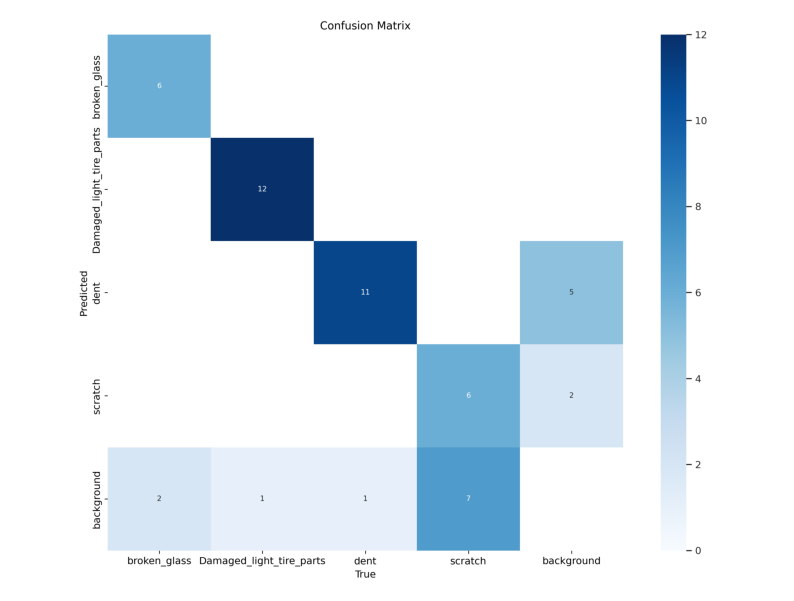

In [34]:
# Confusion Matrix (Extra orders)
fig = plt.figure(figsize=(10, 9))
cm_img = mpimg.imread("/content/runs/detect/train8/confusion_matrix.png")
plt.imshow(cm_img)
plt.axis("off")
fig.show()

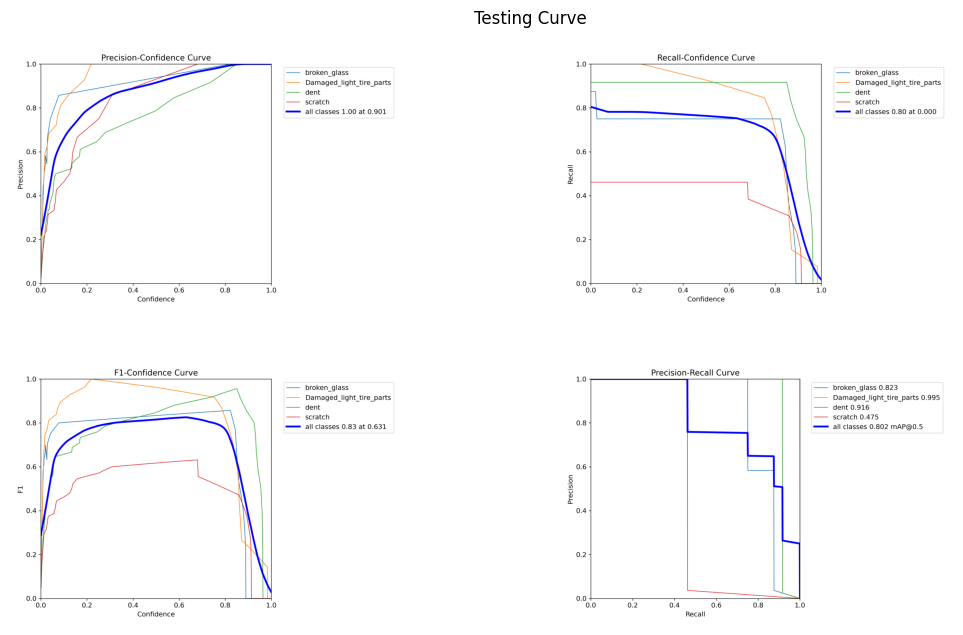

In [40]:
# Tradeoff Curves (Extra orders)
# Precision-confidence curve
# Recall-confidence curve
# F1-score curve
# Precision-recall curve
fig, axs = plt.subplots(2, 2, figsize=(13, 7.5))
curve_list = ["P_curve", "R_curve", "F1_curve", "PR_curve"]
for i, curve in enumerate(curve_list):
    curve_path = "/content/runs/detect/train8/{}.png".format(curve)
    curve_img = mpimg.imread(curve_path)
    axs[i//2, i%2].imshow(curve_img)
    axs[i//2, i%2].axis('off')

# Title
plt.suptitle("Testing Curve", x=0.55, y=0.93)

# Show
plt.show()

In [35]:
# Evaluate on val & test sets
metrics_val  = model.val(data='car_defect.yaml', split='val')
metrics_test = model.val(data='car_defect.yaml', split='test')
print("Validation metrics:", metrics_val)
print("Test metrics:", metrics_test)

Ultralytics 8.3.131 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8n summary (fused): 72 layers, 3,006,428 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1403.0±602.0 MB/s, size: 68.1 KB)


val: Scanning /content/Dataset/val/labels.cache... 27 images, 0 backgrounds, 0 corrupt: 100%|██████████| 27/27 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


                   all         27         46      0.953      0.753      0.802       0.64
          broken_glass          6          8      0.963       0.75      0.823      0.638
Damaged_light_tire_parts         13         13          1      0.885      0.995      0.778
                  dent          9         12       0.87      0.917      0.916      0.759
               scratch          6         13      0.981      0.462      0.475      0.385
Speed: 0.3ms preprocess, 12.6ms inference, 0.0ms loss, 3.2ms postprocess per image
Results saved to runs/detect/train82
Ultralytics 8.3.131 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1225.3±951.2 MB/s, size: 50.6 KB)


val: Scanning /content/Dataset/test/labels... 14 images, 0 backgrounds, 0 corrupt: 100%|██████████| 14/14 [00:00<00:00, 1214.91it/s]

val: New cache created: /content/Dataset/test/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.50it/s]


                   all         14         27      0.817      0.842      0.848      0.675
          broken_glass          4          5      0.736      0.568      0.602      0.427
Damaged_light_tire_parts          6          6       0.91          1      0.995      0.882
                  dent          4          6      0.763          1      0.995      0.839
               scratch          4         10      0.859        0.8        0.8      0.552
Speed: 0.3ms preprocess, 21.3ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/train83
Validation metrics: ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ef8fce6ea10>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    

Running on: 14.jpg

image 1/1 /content/Dataset/val/images/14.jpg: 448x640 1 Damaged_light_tire_parts, 27.4ms


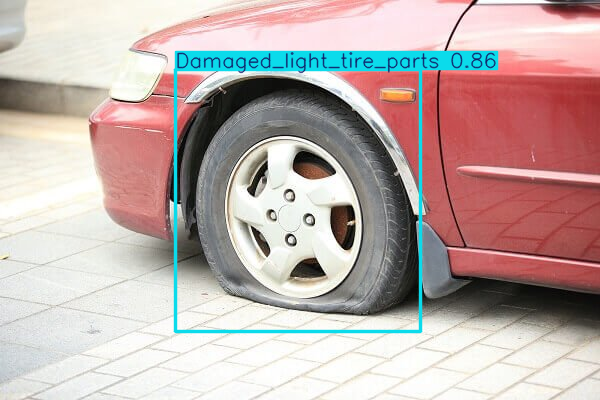

Speed: 3.4ms preprocess, 27.4ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
Running on: 22.jpg

image 1/1 /content/Dataset/val/images/22.jpg: 640x640 1 dent, 26.2ms


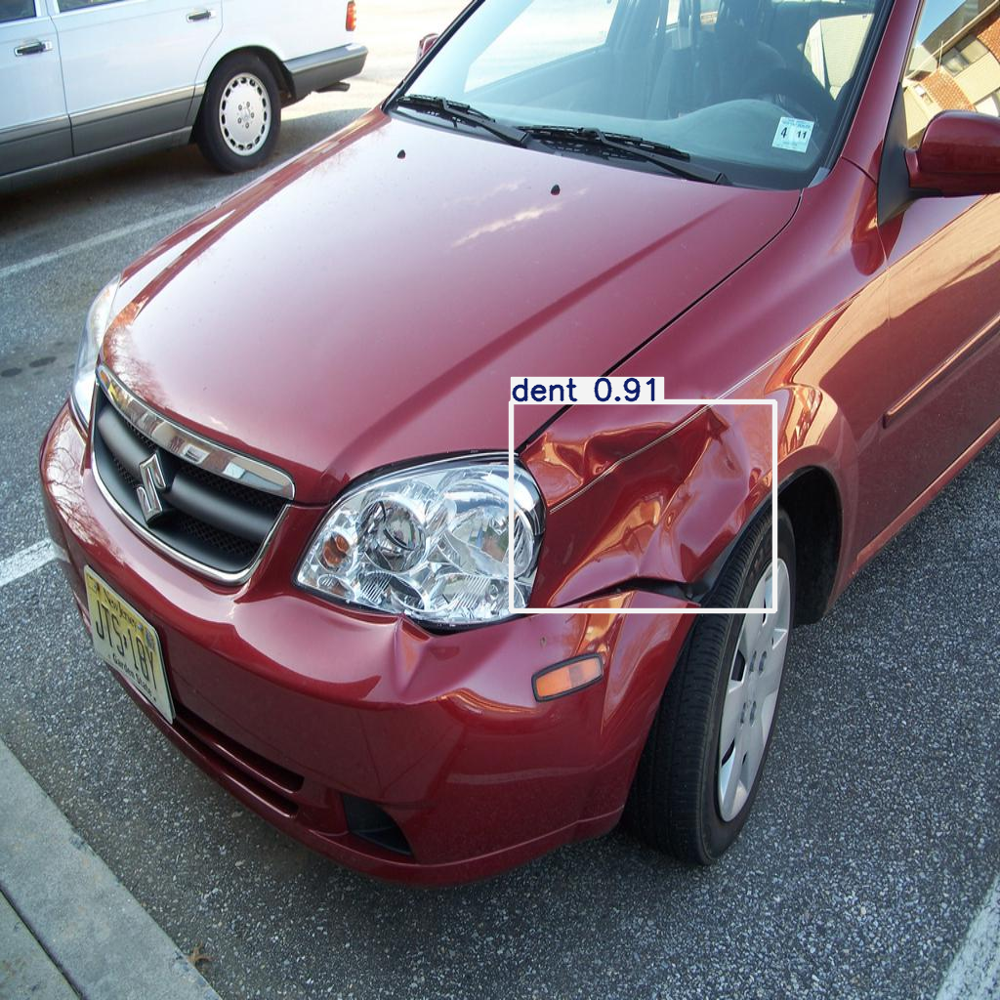

Speed: 5.6ms preprocess, 26.2ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Running on: 29.jpg

image 1/1 /content/Dataset/val/images/29.jpg: 512x640 1 Damaged_light_tire_parts, 1 scratch, 37.3ms


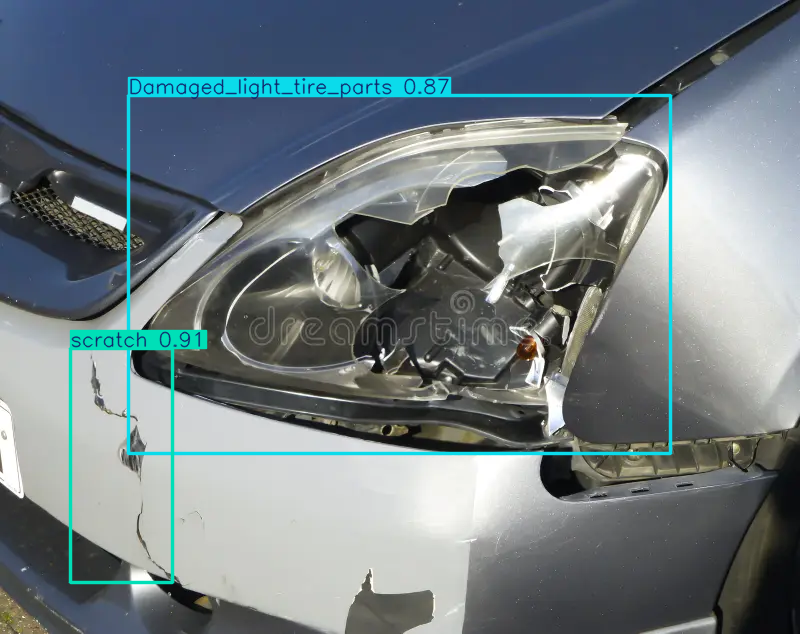

Speed: 3.6ms preprocess, 37.3ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 640)
Running on: 50.jpg

image 1/1 /content/Dataset/val/images/50.jpg: 480x640 1 Damaged_light_tire_parts, 33.9ms


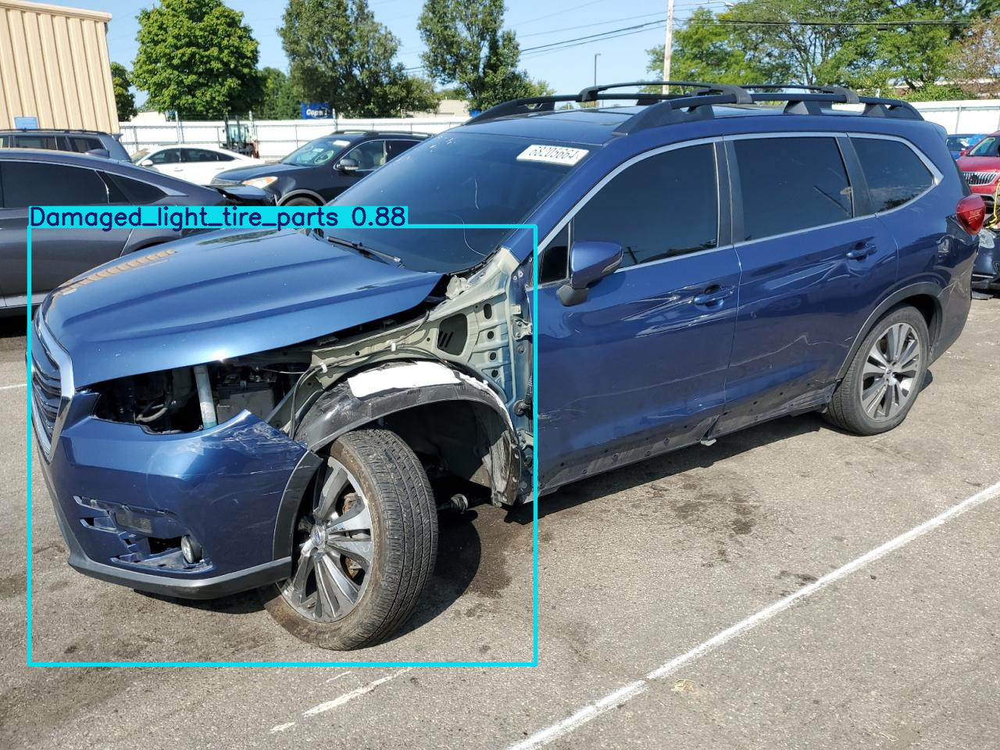

Speed: 2.6ms preprocess, 33.9ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)
Running on: 53.jpg

image 1/1 /content/Dataset/val/images/53.jpg: 480x640 1 Damaged_light_tire_parts, 34.2ms


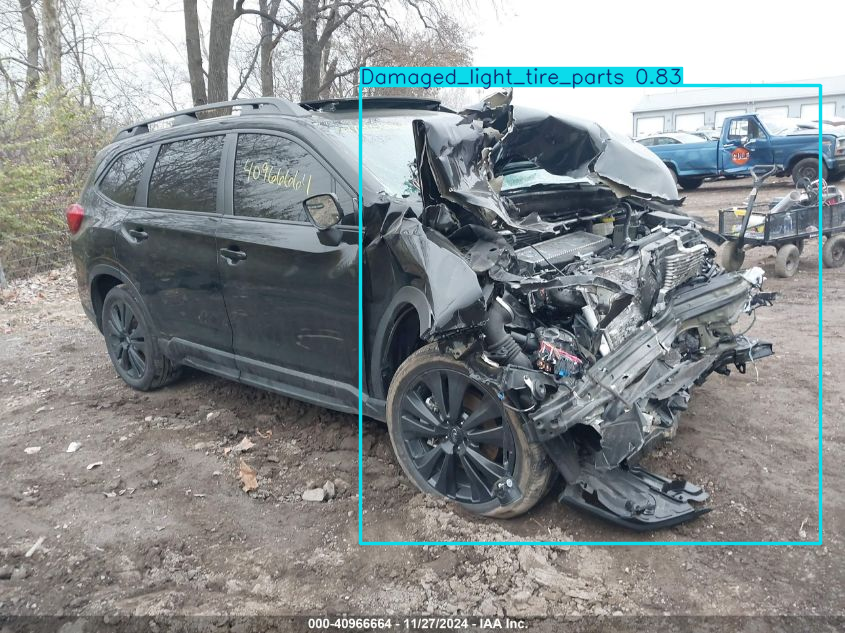

Speed: 3.7ms preprocess, 34.2ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


In [38]:
# Evaluate the trained model using 10 random test images
import random, glob, cv2
from PIL import Image
from IPython.display import display

# Collect all test image paths
test_images = glob.glob(f'{DATA}/val/images/*.jpg')

# Sample two at random (remove seed for true randomness)
sample = random.sample(test_images, 5)

# Inference + display loop
for img_path in sample:
    print(f"Running on: {img_path.split('/')[-1]}")
    # stream=True lets us grab the Result object
    for result in model.predict(
        source=img_path,
        conf=0.5,
        save=False,
        show=False,
        stream=True
    ):
        # plot() draws boxes & returns BGR numpy array
        bgr = result.plot()
        # convert BGR→RGB
        rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
        # show inline
        display(Image.fromarray(rgb))


Running on: 33.jpg

image 1/1 /content/Dataset/val/images/33.jpg: 352x640 1 broken_glass, 25.1ms


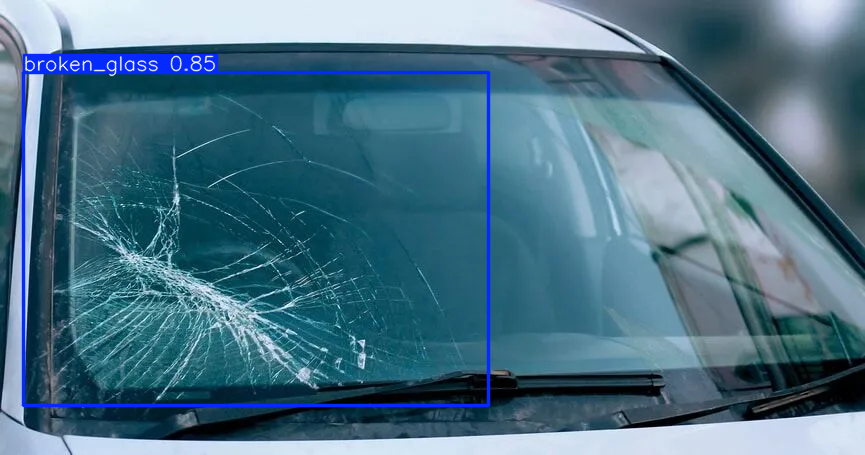

Speed: 2.8ms preprocess, 25.1ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Running on: 9.jpg

image 1/1 /content/Dataset/val/images/9.jpg: 640x640 1 dent, 36.1ms


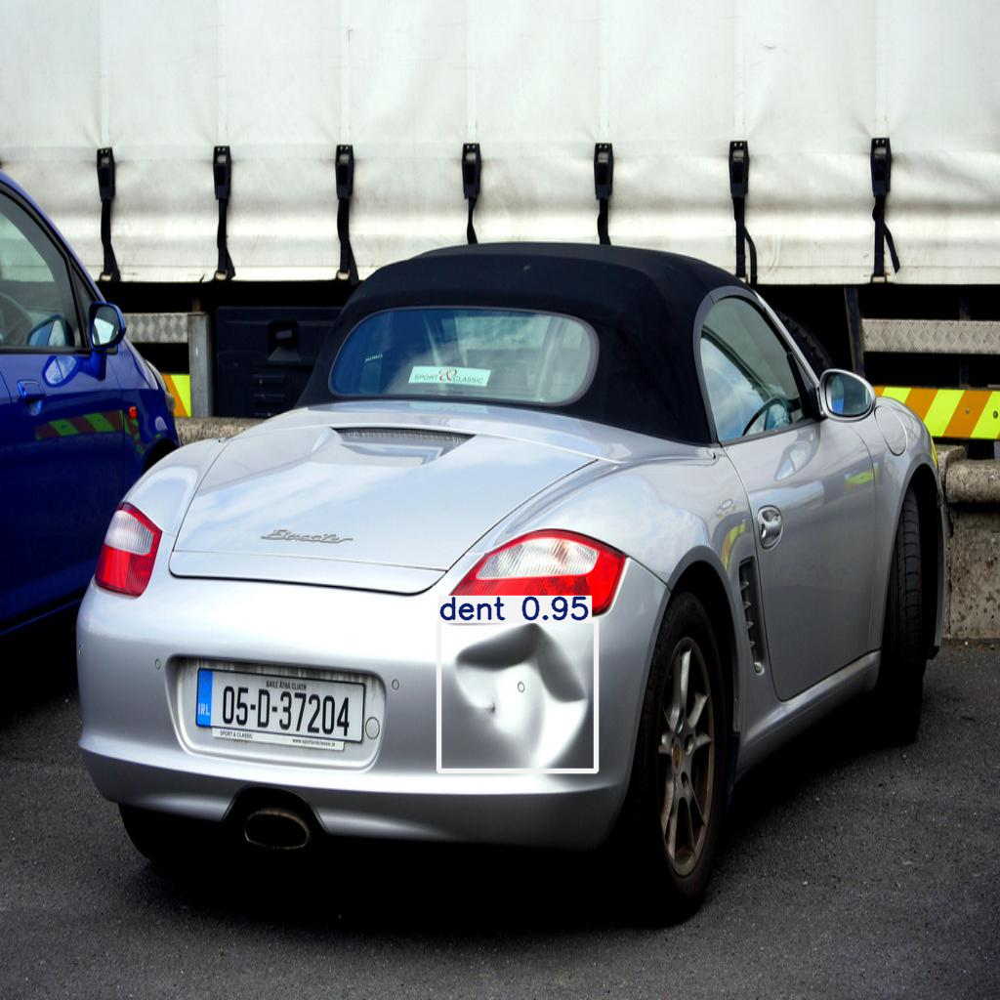

Speed: 7.6ms preprocess, 36.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)
Running on: 3.jpg

image 1/1 /content/Dataset/val/images/3.jpg: 640x640 5 dents, 34.3ms


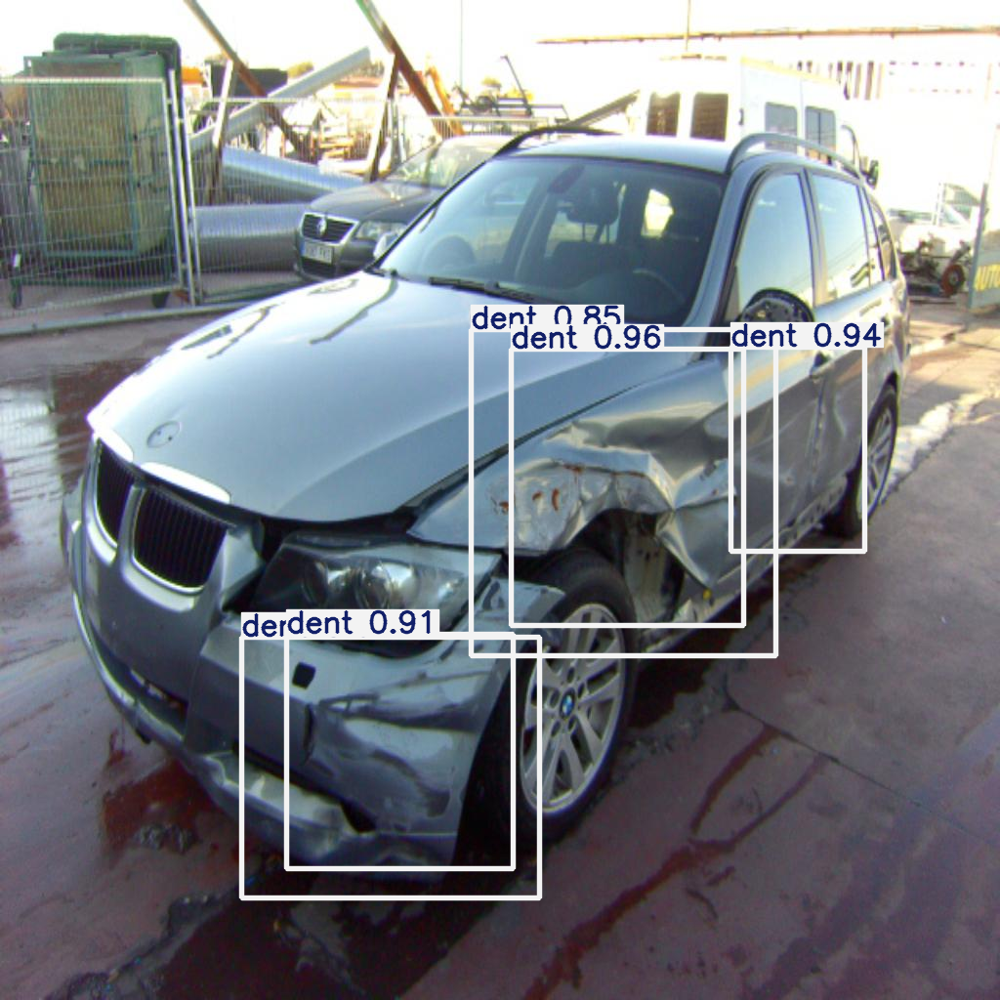

Speed: 5.3ms preprocess, 34.3ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)
Running on: 25.jpg

image 1/1 /content/Dataset/val/images/25.jpg: 384x640 1 Damaged_light_tire_parts, 159.6ms


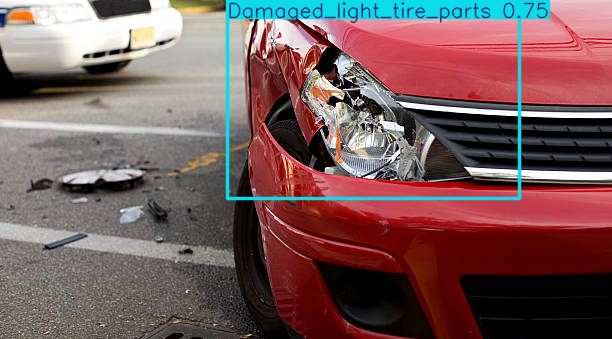

Speed: 5.7ms preprocess, 159.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Running on: 18.jpg

image 1/1 /content/Dataset/val/images/18.jpg: 480x640 1 Damaged_light_tire_parts, 34.5ms


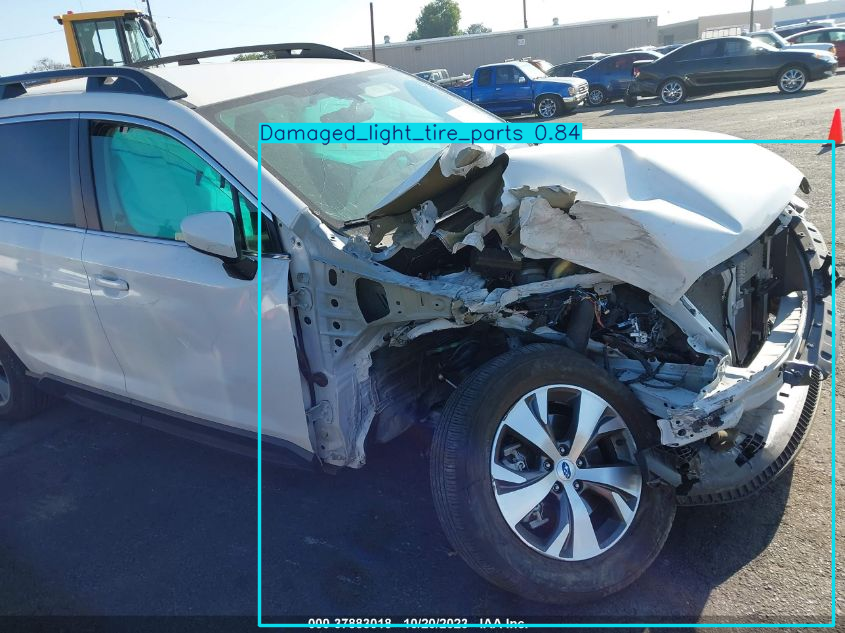

Speed: 4.0ms preprocess, 34.5ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)
Running on: 5.jpg

image 1/1 /content/Dataset/val/images/5.jpg: 640x640 1 broken_glass, 1 dent, 28.9ms


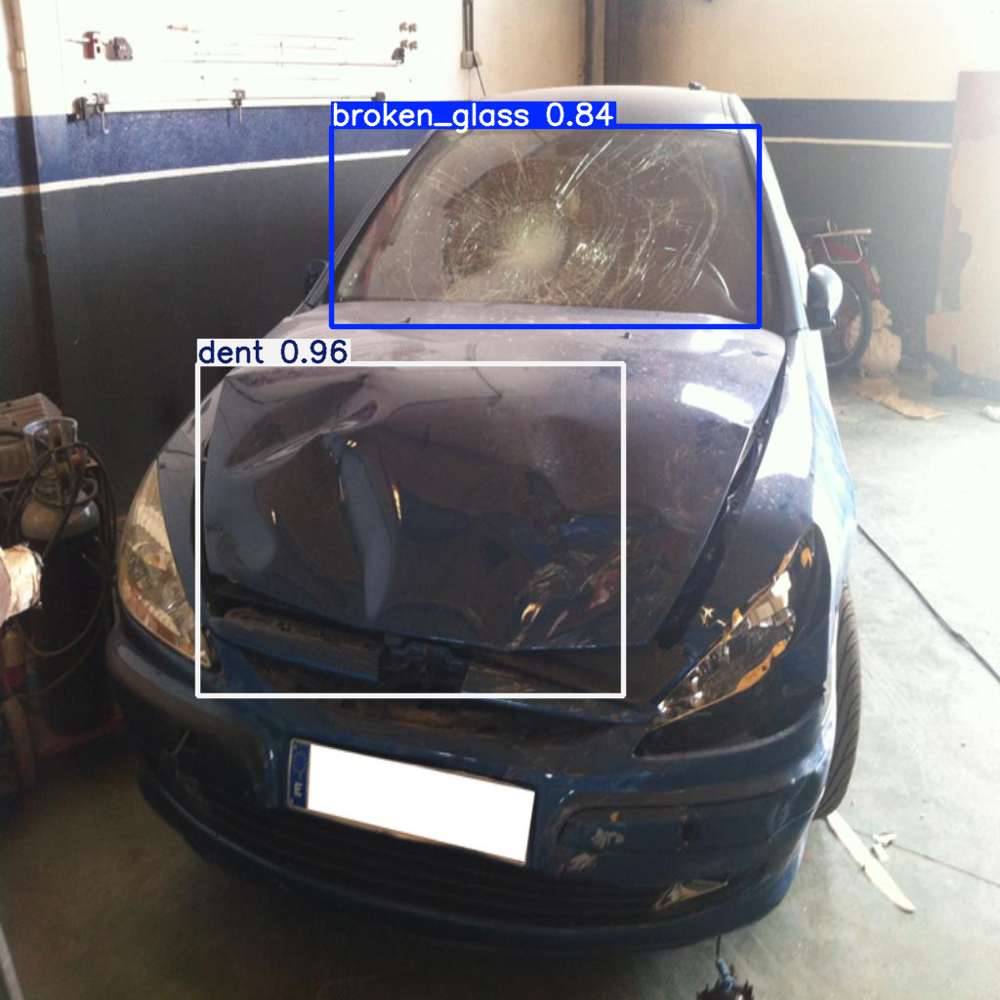

Speed: 5.2ms preprocess, 28.9ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)
Running on: 13.jpg

image 1/1 /content/Dataset/val/images/13.jpg: 480x640 (no detections), 39.8ms


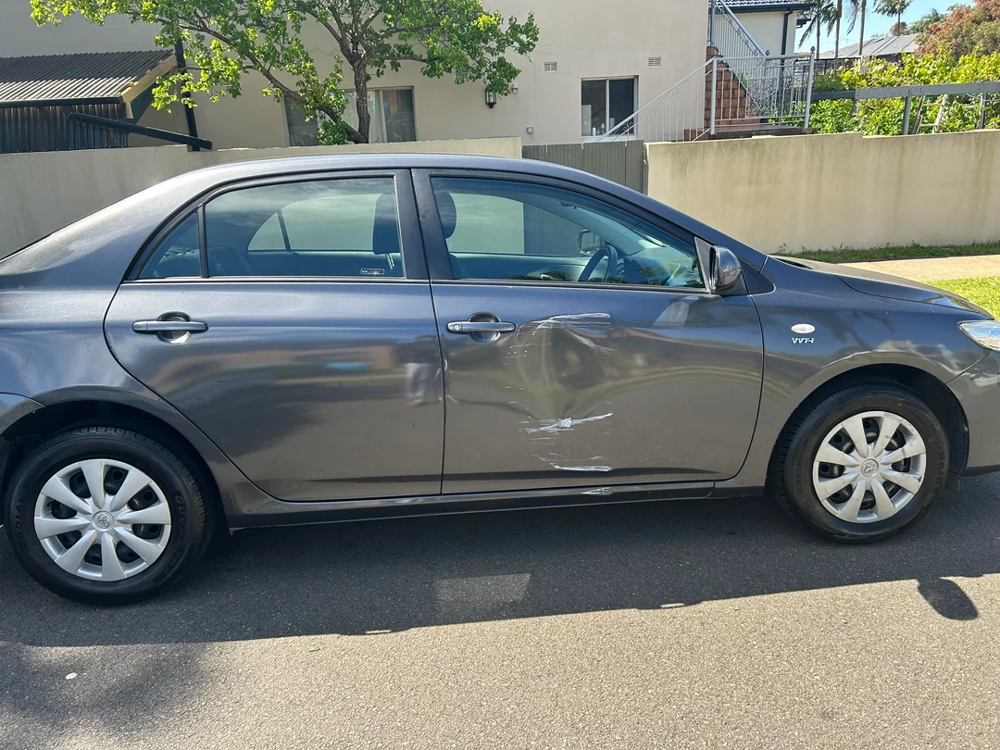

Speed: 5.2ms preprocess, 39.8ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)
Running on: 45.jpg

image 1/1 /content/Dataset/val/images/45.jpg: 448x640 1 Damaged_light_tire_parts, 39.2ms


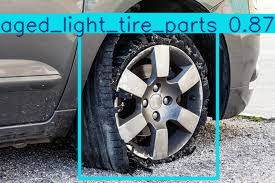

Speed: 3.4ms preprocess, 39.2ms inference, 2.1ms postprocess per image at shape (1, 3, 448, 640)
Running on: 22.jpg

image 1/1 /content/Dataset/val/images/22.jpg: 640x640 1 dent, 35.3ms


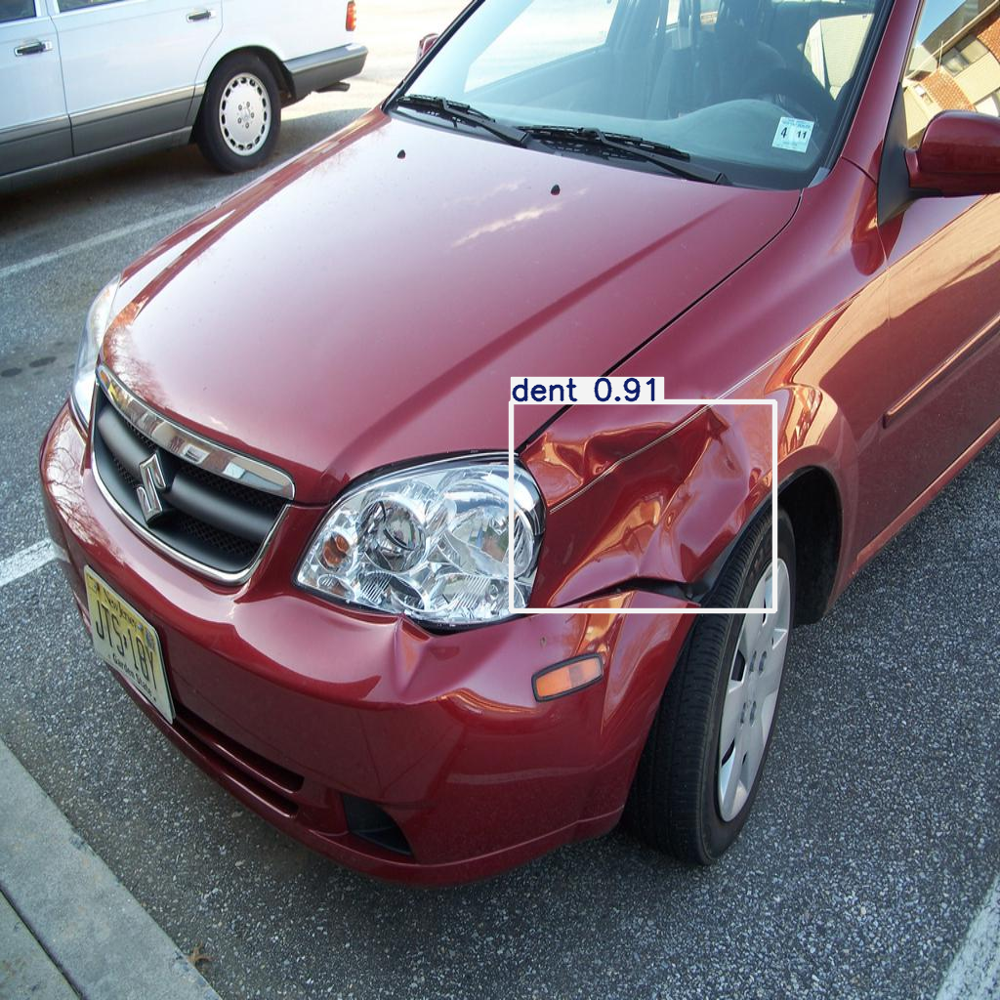

Speed: 4.5ms preprocess, 35.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)
Running on: 8.jpg

image 1/1 /content/Dataset/val/images/8.jpg: 640x640 3 dents, 32.6ms


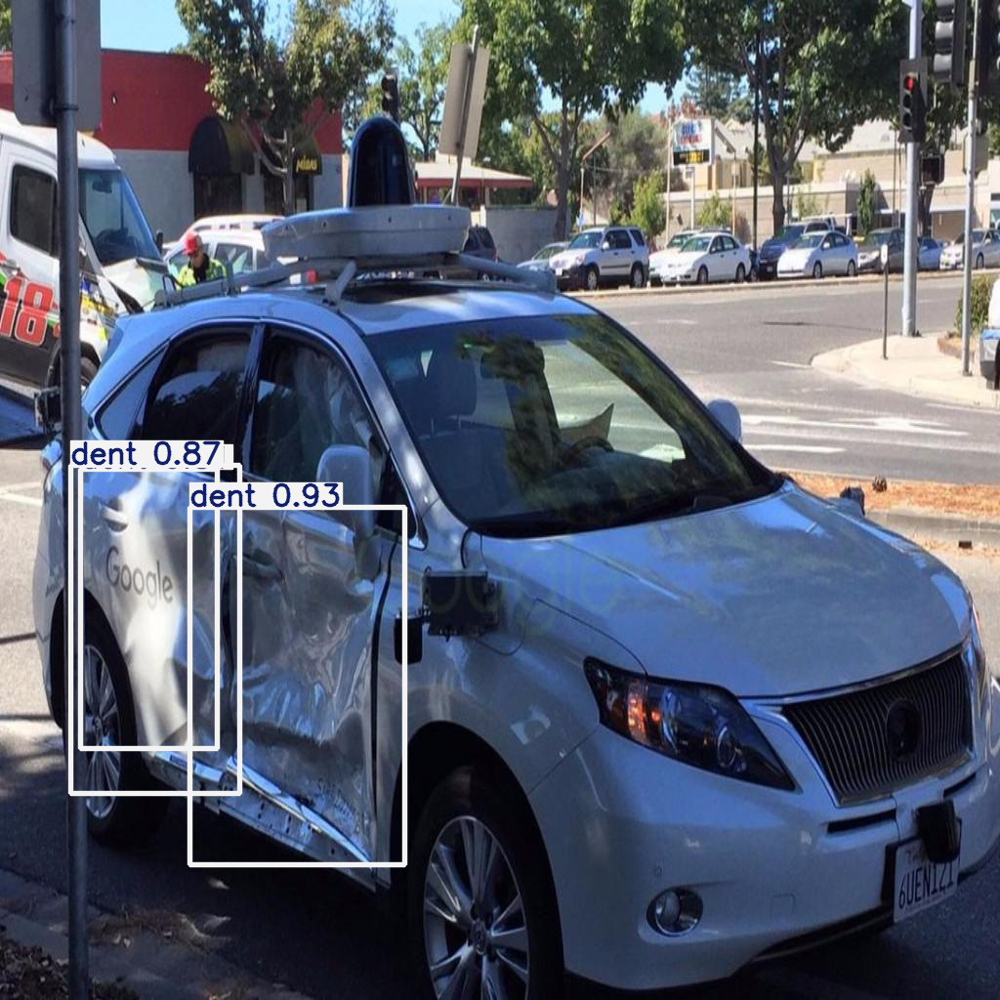

Speed: 4.9ms preprocess, 32.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


In [41]:
# Evaluate the trained model using 10 random test images
import random, glob, cv2
from PIL import Image
from IPython.display import display

# Collect all test image paths
test_images = glob.glob(f'{DATA}/val/images/*.jpg')

# Sample two at random (remove seed for true randomness)
sample = random.sample(test_images, 10)

# Inference + display loop
for img_path in sample:
    print(f"Running on: {img_path.split('/')[-1]}")
    # stream=True lets us grab the Result object
    for result in model.predict(
        source=img_path,
        conf=0.5,
        save=False,
        show=False,
        stream=True
    ):
        # plot() draws boxes & returns BGR numpy array
        bgr = result.plot()
        # convert BGR→RGB
        rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
        # show inline
        display(Image.fromarray(rgb))


Running on: images (1).jpg

image 1/1 /content/images (1).jpg: 448x640 1 dent, 24.8ms


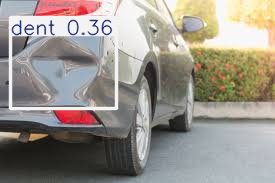

Speed: 4.0ms preprocess, 24.8ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
Running on: images (2).jpg

image 1/1 /content/images (2).jpg: 384x640 2 scratchs, 29.1ms


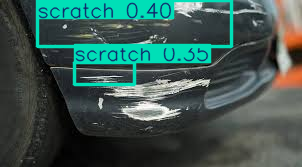

Speed: 2.2ms preprocess, 29.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Running on: images.jpg

image 1/1 /content/images.jpg: 448x640 1 Damaged_light_tire_parts, 1 dent, 26.9ms


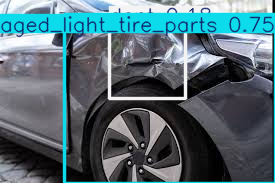

Speed: 2.5ms preprocess, 26.9ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)


In [53]:
# Evaluate trained models using three test samples from Internet
import random, glob, cv2
from PIL import Image
from IPython.display import display

# Collect all test image paths
test_images = glob.glob(f'/content/*.jpg')

# Sample two at random (remove seed for true randomness)
sample = random.sample(test_images, 3)

# Inference + display loop
for img_path in sample:
    print(f"Running on: {img_path.split('/')[-1]}")
    # stream=True lets us grab the Result object
    for result in model.predict(
        source=img_path,
        conf=0.15,
        save=False,
        show=False,
        stream=True
    ):
        # plot() draws boxes & returns BGR numpy array
        bgr = result.plot()
        # convert BGR→RGB
        rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
        # show inline
        display(Image.fromarray(rgb))
